# Social Data Analysis: Olist - Brazilian E-commerce  

## Explainer notebook

This notebook takes the reader through the in-depth analysis that is the basis of the public analysis presented on [the Olist website](https://jako4689.github.io/). The focus of this notebook is to more specifically explain how the data analysis was performed. 

In order to perfect the visual finish of the website, we utilized the properties of `plotly.chart_studios`([link](https://chart-studio.plotly.com/feed/#/ )) to get the visualizations the way we want. `plotly.chart_studios` is a tool that makes it easier to customize and get the graphs the way the user wants. It works by uploading the data og `plotly` chart and then editing the graphs/charts through the chart studio interface. The plots used on the website have all been edited in chart studios. However, to ensure that none of the visualizations used on the website will be changed, the code that uploads the data to `plotly.chart_studios` has been separated from the explainer notebook. However, all the plots in the website was initially derived in this explainer notebook before being edited. 


## 1. Motivation

We are two freelance data science consultants, Anders and Jakob, who strive to improve our clients understanding and usage of social data. 

Our task is to help our client, the Brazilian E-commerce company Olist, to continue their rapid growth. The client has identified customer satisfaction as a Key Performance Indicator, which is why this project will focus on improving on this matter. Olist has provided us with data from over 100.000 orders made between 2016 and 2018. The dta contains spatial as well as temporal information and each order includes a customer review rating, which is between 1 and 5. Customer satisfaction can be affected by several factors, and therefore our goal is to identify which factors that affect customer satisfaction the most before coming up with recommendations on how to improve on these matters. However, before we get into this, we start by getting an overview of some of the general patterns in the data in order to better understand Olist's products and their customers and sellers.       


## 2. Basic stats

- Write about your choices in data cleaning and preprocessing
- Write a short section that discusses the dataset stats, containing key points/plots from your exploratory data analysis.

The first step is importing the dataset. The data is structured as a relational database with multiple tables containing different information. Below is an illustration of the relational data schema made by olist
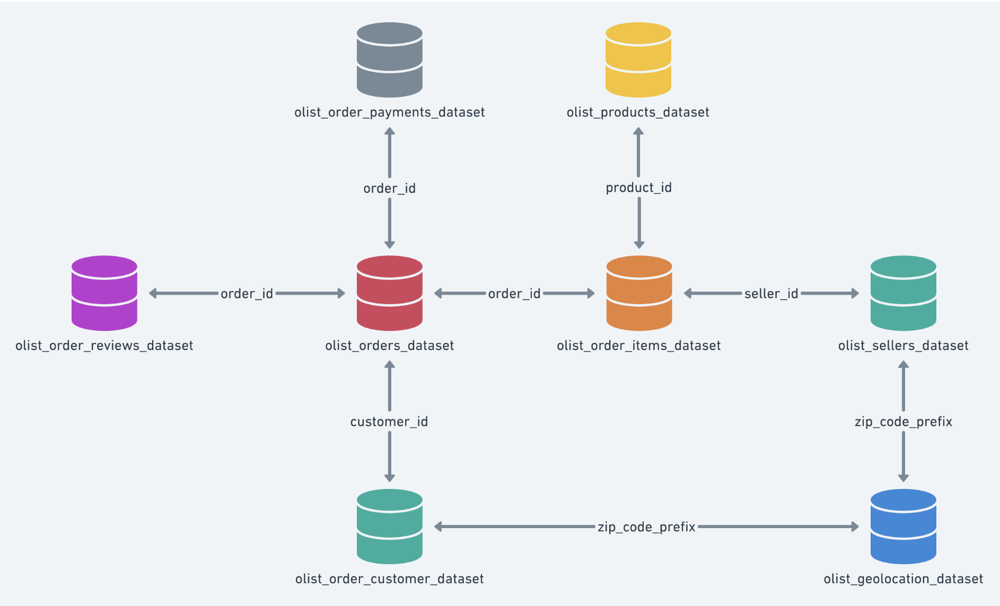


Looking at the different tables, we obviously need the `olist_order_reviews_dataset` to conduct the analysis of customer reviews. However, we are also interested in the data concerning the specific order, the customer and seller and the products. We therefore use the following tables:
- `olist_orders_dataset`
- `olist_order_items_dataset`
- `olist_order_customer_dataset`
- `olist_sellers_dataset`
- `olist_products_dataset`
- `olist_geolocation_dataset`


With this in mind, let's start coding!

The cell below shows all the necessary library imports to run the notebook. All libraries used should be possible to import using `pip install`.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import ast
import pydeck as pdk
import warnings
warnings.filterwarnings('ignore')

import plotly.io as pio
pio.renderers.default='notebook'

Let's go ahead and load all the useful tables into memory.

In [2]:
reviews = pd.read_csv('archive/olist_order_reviews_dataset.csv')
orders = pd.read_csv('archive/olist_orders_dataset.csv')
customers = pd.read_csv('archive/olist_customers_dataset.csv')
orderItems = pd.read_csv('archive/olist_order_items_dataset.csv')
sellers = pd.read_csv('archive/olist_sellers_dataset.csv')
products = pd.read_csv('archive/olist_products_dataset.csv')
catNameTranslation = pd.read_csv('archive/product_category_name_translation.csv')
geoLoc = pd.read_csv('archive/olist_geolocation_dataset.csv')
geoAgg = geoLoc.groupby('geolocation_zip_code_prefix',as_index=False).mean()

We start by looking into the reviews table as this is our main focus. When we have gained ourselves an overview, we go on an merge the additional tables onto it.

In [3]:
print('No. rows in review table:', len(reviews))
print('No. unique reviews:', len(np.unique(reviews.review_id.values)))
print('No. unique order IDs:', len(np.unique(reviews.order_id.values)))

reviews

No. rows in review table: 99224
No. unique reviews: 98410
No. unique order IDs: 98673


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
...,...,...,...,...,...,...,...
99219,574ed12dd733e5fa530cfd4bbf39d7c9,2a8c23fee101d4d5662fa670396eb8da,5,NaN,NaN,2018-07-07 00:00:00,2018-07-14 17:18:30
99220,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42
99221,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43
99222,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13


It can be seen there are more rows than there are unique review IDs meaning there must be duplicate review IDs. We also see that there are more unique review IDs than there are unique order IDs meaning some orders will have multiple Let's look further into these duplicates. We start by assessing the review ID duplicates...

In [4]:
review_duplicates = reviews[reviews.duplicated(subset=['review_id'],keep=False)].sort_values('review_id')

print('No. duplicated review IDs:', len(np.unique(review_duplicates.review_id.values)))
review_duplicates

No. duplicated review IDs: 789


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
46678,00130cbe1f9d422698c812ed8ded1919,dfcdfc43867d1c1381bfaf62d6b9c195,1,NaN,"O cartucho ""original HP"" 60XL não é reconhecid...",2018-03-07 00:00:00,2018-03-20 18:08:23
29841,00130cbe1f9d422698c812ed8ded1919,04a28263e085d399c97ae49e0b477efa,1,NaN,"O cartucho ""original HP"" 60XL não é reconhecid...",2018-03-07 00:00:00,2018-03-20 18:08:23
90677,0115633a9c298b6a98bcbe4eee75345f,78a4201f58af3463bdab842eea4bc801,5,NaN,NaN,2017-09-21 00:00:00,2017-09-26 03:27:47
63193,0115633a9c298b6a98bcbe4eee75345f,0c9850b2c179c1ef60d2855e2751d1fa,5,NaN,NaN,2017-09-21 00:00:00,2017-09-26 03:27:47
92876,0174caf0ee5964646040cd94e15ac95e,f93a732712407c02dce5dd5088d0f47b,1,NaN,Produto entregue dentro de embalagem do fornec...,2018-03-07 00:00:00,2018-03-08 03:00:53
...,...,...,...,...,...,...,...
31120,fe5c833752953fed3209646f1f63b53c,4863e15fa53273cc7219c58f5ffda4fb,1,NaN,"Comprei dois produtos e ambos, mesmo enviados ...",2018-02-28 00:00:00,2018-02-28 13:57:52
7870,ff2fc9e68f8aabfbe18d710b83aabd30,2da58e0a7dcfa4ce1e00fad9d03ca3b5,2,NaN,NaN,2018-03-17 00:00:00,2018-03-19 11:44:15
82521,ff2fc9e68f8aabfbe18d710b83aabd30,1078d496cc6ab9a8e6f2be77abf5091b,2,NaN,NaN,2018-03-17 00:00:00,2018-03-19 11:44:15
73951,ffb8cff872a625632ac983eb1f88843c,c44883fc2529b4aa03ca90e7e09d95b6,3,NaN,NaN,2017-07-22 00:00:00,2017-07-26 13:41:07


We see that the duplicate review IDs have different order IDs, which does not make much intuitive sense. Is this because the review is made on multiple orders or is it an error in data? Let's look further into these orders..

Below we check if the duplicated reviews that has different orderIDs has the same customer. This is not the case, which seems suspicious, since we expect a review is made by a single customer on a single order. We also checked to see if the reviews were connected to specific products or sellers, although it would not make much sense given the way the relational database is structured, but we were not able to find any pattern.

In [5]:
review_duplicates = pd.merge(review_duplicates, orders, how='left')
review_duplicates = pd.merge(review_duplicates, orderItems, how='left')[['review_id', 'order_id', 'customer_id', 'product_id', 'seller_id']]
review_duplicates

,review_id,order_id,customer_id,product_id,seller_id
0,00130cbe1f9d422698c812ed8ded1919,dfcdfc43867d1c1381bfaf62d6b9c195,a7026133ddbd2e86c83ecd4dfa4dbe01,36f60d45225e60c7da4558b070ce4b60,00fc707aaaad2d31347cf883cd2dfe10
1,00130cbe1f9d422698c812ed8ded1919,04a28263e085d399c97ae49e0b477efa,fef2e5e63da9f3e1dd89e8e319468657,3f14d740544f37ece8a9e7bc8349797e,6973a06f484aacf400ece213dbf3d946
2,0115633a9c298b6a98bcbe4eee75345f,78a4201f58af3463bdab842eea4bc801,d39c97549a412a82dacf30fe5f144cb0,7814c273ab16783d73a9863ebfa8b141,1025f0e2d44d7041d6cf58b6550e0bfa
3,0115633a9c298b6a98bcbe4eee75345f,0c9850b2c179c1ef60d2855e2751d1fa,3bb15be93abf3c2a684d163ba6faaa5b,7b5d8be0e04080e4c8ee6a7ec2f1f597,1025f0e2d44d7041d6cf58b6550e0bfa
4,0115633a9c298b6a98bcbe4eee75345f,0c9850b2c179c1ef60d2855e2751d1fa,3bb15be93abf3c2a684d163ba6faaa5b,7b5d8be0e04080e4c8ee6a7ec2f1f597,1025f0e2d44d7041d6cf58b6550e0bfa
...,...,...,...,...,...
1877,fe5c833752953fed3209646f1f63b53c,4863e15fa53273cc7219c58f5ffda4fb,d585ba9998251ba8cc0ee6ed21683b0d,ee0c1cf2fbeae95205b4aa506f1469f0,cc419e0650a3c5ba77189a1882b7556a
1878,ff2fc9e68f8aabfbe18d710b83aabd30,2da58e0a7dcfa4ce1e00fad9d03ca3b5,dd9e6825c25b74726720391d01006dfc,893b9464c6ab7f700148fe9db838b6b4,55bb6fe5bebe5012e2d7d9928e1128ff
1879,ff2fc9e68f8aabfbe18d710b83aabd30,1078d496cc6ab9a8e6f2be77abf5091b,d875d4a36905c7faf94195dd91f1101b,3948f284081821f4e27ba8c23d4cbc9a,312ba1d77e9c332ef21f9598b7f64cd7
1880,ffb8cff872a625632ac983eb1f88843c,c44883fc2529b4aa03ca90e7e09d95b6,ed9928905c52127d7f9dfbff8229255b,7c1bd920dbdf22470b68bde975dd3ccf,cc419e0650a3c5ba77189a1882b7556a


Instead, we decided to remove these duplicated reviews from the analysis. After removing the 1603 duplicated rows, we now have 97621 unique reviews in the table.

In [6]:
reviews = reviews.drop_duplicates(subset=['review_id'], keep=False)

In [7]:
print('No. rows in review table:', len(reviews))
print('No. unique reviews:', len(np.unique(reviews.review_id.values)))
print('No. unique order IDs:', len(np.unique(reviews.order_id.values)))

reviews

No. rows in review table: 97621
No. unique reviews: 97621
No. unique order IDs: 97530


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
...,...,...,...,...,...,...,...
99219,574ed12dd733e5fa530cfd4bbf39d7c9,2a8c23fee101d4d5662fa670396eb8da,5,NaN,NaN,2018-07-07 00:00:00,2018-07-14 17:18:30
99220,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42
99221,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43
99222,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13


Now, we also wanted to look into why there are less unique order IDs than reviews in the reviews table. Let's have a look at the duplicates...

In [8]:
order_duplicates = reviews[reviews.duplicated(subset=['order_id'],keep=False)].sort_values('order_id')

print('No. unique review IDs:', len(np.unique(order_duplicates.review_id.values)))
print('No. unique order IDs:', len(np.unique(order_duplicates.order_id.values)))
order_duplicates

No. unique review IDs: 182
No. unique order IDs: 91


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
17847,2eab0b2e6f5bded4d9b0b2afcfdf4534,02e0b68852217f5715fb9cc885829454,4,NaN,Gostei chegou rapidinho,2017-12-03 00:00:00,2017-12-03 21:56:37
35812,fa493ead9b093fb0fa6f7d4905b0ef3b,02e0b68852217f5715fb9cc885829454,4,NaN,Gostei e entregou rapidinho,2017-12-01 00:00:00,2017-12-03 21:57:31
69438,405eb2ea45e1dbe2662541ae5b47e2aa,03c939fd7fd3b38f8485a0f95798f1f6,3,NaN,Seria ótimo se tivesem entregue os 3 (três) pe...,2018-03-06 00:00:00,2018-03-06 19:50:32
8273,b04ed893318da5b863e878cd3d0511df,03c939fd7fd3b38f8485a0f95798f1f6,3,NaN,Um ponto negativo que achei foi a cobrança de ...,2018-03-20 00:00:00,2018-03-21 02:28:23
43105,c793b25686e244588d4fc71964c95a2c,04f1827088d972a62224f5203a071500,1,NaN,NaN,2018-01-07 00:00:00,2018-01-07 11:14:04
...,...,...,...,...,...,...,...
12594,bc85f39adbafaddfda29d372f3825873,f63a31c3349b87273468ff7e66852056,5,NaN,NaN,2018-01-11 00:00:00,2018-01-12 02:05:02
86641,24ad2fc85ec000ba4fbfd9841d9a1972,fd61441ba2a7b57e6342862e779b10b0,4,NaN,"Tem que retirar nos correios, muito incômodo",2017-10-14 00:00:00,2017-10-16 21:23:28
1157,3c625d52413314975e47e144fbc3cb8e,fd61441ba2a7b57e6342862e779b10b0,5,NaN,NaN,2017-10-04 00:00:00,2017-10-05 18:02:50
18783,80f25f32c00540d49d57796fb6658535,ff850ba359507b996e8b2fbb26df8d03,5,NaN,"Envio rapido, produto conforme descrito no anu...",2017-08-22 00:00:00,2017-08-25 11:40:22


Looking at the table above, it appears as if the reviews are actually distinct in many cases and that the order have simply been reviewed multiple times. Maybe these orders contain multiple products that arrive at different times? Or maybe the order contains products from different sellers? We check that by joining on the order items data.

In [9]:
order_duplicates = pd.merge(order_duplicates, orders, how='left')
order_duplicates = pd.merge(order_duplicates, orderItems)[['review_id', 'order_id', 'customer_id', 'product_id', 'seller_id']]

print('No. unique review IDs:', len(np.unique(order_duplicates.review_id.values)))
print('No. unique order IDs:', len(np.unique(order_duplicates.order_id.values)))
print('No. unique customer IDs:', len(np.unique(order_duplicates.customer_id.values)))
print('No. unique product IDs:', len(np.unique(order_duplicates.product_id.values)))
print('No. unique seller IDs:', len(np.unique(order_duplicates.seller_id.values)))

order_duplicates.sort_values('order_id')

No. unique review IDs: 182
No. unique order IDs: 91
No. unique customer IDs: 91
No. unique product IDs: 91
No. unique seller IDs: 65


,review_id,order_id,customer_id,product_id,seller_id
0,2eab0b2e6f5bded4d9b0b2afcfdf4534,02e0b68852217f5715fb9cc885829454,12b78d9eacb77edde80d19b9528bcfe9,2028bf1b01cafb2d2b1901fca4083222,cc419e0650a3c5ba77189a1882b7556a
1,fa493ead9b093fb0fa6f7d4905b0ef3b,02e0b68852217f5715fb9cc885829454,12b78d9eacb77edde80d19b9528bcfe9,2028bf1b01cafb2d2b1901fca4083222,cc419e0650a3c5ba77189a1882b7556a
2,405eb2ea45e1dbe2662541ae5b47e2aa,03c939fd7fd3b38f8485a0f95798f1f6,2a35ad9f439dfc62d35a0202e71d6c66,ab5da1daa941470d14366f4e76a99dd2,d91fb3b7d041e83b64a00a3edfb37e4f
3,b04ed893318da5b863e878cd3d0511df,03c939fd7fd3b38f8485a0f95798f1f6,2a35ad9f439dfc62d35a0202e71d6c66,ab5da1daa941470d14366f4e76a99dd2,d91fb3b7d041e83b64a00a3edfb37e4f
4,c793b25686e244588d4fc71964c95a2c,04f1827088d972a62224f5203a071500,03c1a904f35ad2f91e103b348cf53c3a,daf9301b3e3756d45250765852ed0dfd,004c9cd9d87a3c30c522c48c4fc07416
...,...,...,...,...,...
211,bc85f39adbafaddfda29d372f3825873,f63a31c3349b87273468ff7e66852056,bf04d8d8923728c5bc0e982837507773,b861b1b731a9102704784b9912aca82a,4736e9d642ef4257cd7622516931eb51
212,24ad2fc85ec000ba4fbfd9841d9a1972,fd61441ba2a7b57e6342862e779b10b0,e36917a47d5bf39bd3f38bcafb3d438f,bb15f9ba2ec6e36ab6c9e88d17430d64,b372ee768ed69e46ca8cdbd267aa7a38
213,3c625d52413314975e47e144fbc3cb8e,fd61441ba2a7b57e6342862e779b10b0,e36917a47d5bf39bd3f38bcafb3d438f,bb15f9ba2ec6e36ab6c9e88d17430d64,b372ee768ed69e46ca8cdbd267aa7a38
214,80f25f32c00540d49d57796fb6658535,ff850ba359507b996e8b2fbb26df8d03,219399e5496f8ca1dc6f68753131c084,d2bea3c01e172037caa99b2d138f39d0,9674754b5a0cb32b638cec001178f799


It appears as if these duplicate orders are actually just the case of a customer performing multiple reviews on the same order. There are exactly the same amount of unique orders, unique customers and unique products and there are even less unique sellers, which probably just means that the sellers have had multiple orders reviewed twice. The added rows are a result of multi-product orders, which can be seem by the code below.

In [10]:
multi_item_orders = order_duplicates[order_duplicates.duplicated(subset=['review_id'],keep=False)].sort_values('order_id').reset_index()
print("Number of multiple item orders: ", len(np.unique(multi_item_orders.review_id.values)))
print("Added rows: ", len(multi_item_orders)-len(np.unique(multi_item_orders.review_id.values)))

Number of multiple item orders:  20
Added rows:  34


So, these order duplicates occur in the data simply because in 182 cases, the customer has submitted their review twice. Since there are so few observations it is tempting to just remove these reviews, but we decided to include only the last review. Maybe the reviewer wanted to change their score or add a comment...

In [11]:
reviews = reviews.sort_values('review_answer_timestamp').drop_duplicates(subset=['order_id'], keep='last')

print('No. rows in review table:', len(reviews))
print('No. unique reviews:', len(np.unique(reviews.review_id.values)))
print('No. unique order IDs:', len(np.unique(reviews.order_id.values)))

reviews

No. rows in review table: 97530
No. unique reviews: 97530
No. unique order IDs: 97530


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
37547,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,1,NaN,nao recebi o produto e nem resposta da empresa,2016-10-06 00:00:00,2016-10-07 18:32:28
5503,49f695dffa457eaba90d388a5c37e942,e5215415bb6f76fe3b7cb68103a0d1c0,1,NaN,"PRODUTO NÃO CHEGOU,E JÁ PASSOU O PRAZO DE ENTREGA",2016-10-09 00:00:00,2016-10-11 14:31:29
60439,743d98b1a4782f0646898fc915ef002a,e2144124f98f3bf46939bc5183104041,4,NaN,NaN,2016-10-15 00:00:00,2016-10-16 03:20:17
28075,53752edb26544dd41c1209f582c9c589,b8b9d7046c083150cb5360b83a8ebb51,5,NaN,O pedido foi entregue antes do prazo pr0metido,2016-10-16 01:00:00,2016-10-16 15:45:11
41042,b2d5d8db2a841d27a72e4c06c6212368,9aa3197e4887919fde0307fc23601d7a,4,NaN,Só chegou uma parte do pedido ate agora..,2016-10-15 00:00:00,2016-10-17 21:02:49
...,...,...,...,...,...,...,...
46904,6c50d16eb583d5db7e841b77e89b7045,0b223d92c27432930dfe407c6aea3041,5,NaN,NaN,2018-08-31 00:00:00,2018-10-24 16:27:36
14687,abf08328d2f1f0e8a33eee9f52f502f6,99e4a1f9377bf28f08f54a2eecccbf0d,5,NaN,NaN,2018-02-02 00:00:00,2018-10-24 18:26:25
92802,6c883909cf53725a13caf477a70f00a4,7ce4e38f4eadd993bb5b2e60bb7f7bec,5,Muito bonita,"Amei a mesinha, que pena que me confundir na c...",2018-08-16 00:00:00,2018-10-24 21:34:38
49615,728d5cfdc7283cfd0a8061d7581a19f8,7e8072dc0f35ebb0c1b2a4743e0f179a,5,NaN,NaN,2018-07-12 00:00:00,2018-10-26 21:36:41


We now have a table with 97530 rows each denoting a unique review for a unique order. Let's get on with the analysis!

We're going to focus on the review score. It would be interesting to conduct an analysis of the textual responses using NLP methodology, but neither of us have had the time to learn portuguese, which makes it difficult for us to validate our results. Also, only about half of the reviews have textual responses...
Let's look at the distribution of the review scores.


In [12]:
print('No. textual reviews:', sum(reviews.review_comment_message.isna()))

No. textual reviews: 57198


In [13]:
import plotly.express as px


In [14]:
print('Possible review scores: ', np.unique(reviews.review_score.values))
print('Average review score: ', np.mean(reviews.review_score.values))
print()

fig = px.histogram(reviews, x="review_score")
fig.show()


Possible review scores:  [1 2 3 4 5]
Average review score:  4.091284732902697



The results above show a generally positive feedback with an average of above 4/5 and with 5/5 as the most common score. This will be very satisfying to hear for our client! However, there are still over 10k very disatisfied customers, who gave a review score of 1/5! Olist wants all of their customers to be satisfied and they consider a score of least 4/5 to be a satisfied customer.

Now we will build one main dataframe by joining the beforementioned tables into one. The main dataframe is build in the cells below by merging first the `olist_order_reviews_dataset` table with the `olist_orders_dataset` and then following the relational schema to merge on the rest of the tables. In the cell below, we merge reviews and orders into one dataframe `df` and then merge it with the customer table. After this, the dataframe still has the same number of observations. We then merge the order items table onto the dataframe. This will change the number of observations because one order can have multiple items. Thereafter we merge the remaining needed tables, all of which does not change the number of observations in the dataframe.  

In [15]:
df = pd.merge(reviews, orders, how='left')
df = pd.merge(df,customers)
df = pd.merge(df,orderItems)
df = pd.merge(df,sellers)
df = pd.merge(df,products)
df = pd.merge(df,catNameTranslation,how='left')
df = pd.merge(df,geoAgg,left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix',how='left',suffixes = (None,'_customer'))
df = pd.merge(df,geoAgg,left_on='seller_zip_code_prefix', right_on='geolocation_zip_code_prefix',how='left',suffixes = (None,'_seller'))

We now have a large dataframe consisting of 110445 rows and 42 columns, where each row is unique. However, only 96834 of the rows are unique orders and reviews. This is because one order can have multiple products. Therefore, each row denotes a unique order-product combination. Note, before merging with supplemental data the amount of unique reviews was 97530 and now it is 96834, ie. 696 observations that were lost when merging. This happened because there are some missing information in the supplemental tables. If we weren't interested in losing observations, we could have kept the obserations, but then they would have missing values, which ultimately would have made us remove them anyways. 

In [16]:
print('No. rows: ', df.shape[0])
print('No. columns: ', df.shape[1])
print()
print('No. unique order IDs:', len(np.unique(df.order_id.values)))
print('No. unique reviews:', len(np.unique(df.review_id.values)))
print('No. unique products:', len(np.unique(df.product_id.values)))
print()
print('Unique combinations of order, product:', len(df.drop_duplicates(['order_id','review_id','order_item_id'])))
df

No. rows:  110445
No. columns:  42

No. unique order IDs: 96834
No. unique reviews: 96834
No. unique products: 32497

Unique combinations of order, product: 110445


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,...,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller
0,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,1,NaN,nao recebi o produto e nem resposta da empresa,2016-10-06 00:00:00,2016-10-07 18:32:28,86dc2ffce2dfff336de2f386a786e574,delivered,2016-09-15 12:16:38,...,16.0,16.0,16.0,health_beauty,14600.0,-20.585751,-47.863693,81810.0,-25.507014,-49.275963
1,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,1,NaN,nao recebi o produto e nem resposta da empresa,2016-10-06 00:00:00,2016-10-07 18:32:28,86dc2ffce2dfff336de2f386a786e574,delivered,2016-09-15 12:16:38,...,16.0,16.0,16.0,health_beauty,14600.0,-20.585751,-47.863693,81810.0,-25.507014,-49.275963
2,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,1,NaN,nao recebi o produto e nem resposta da empresa,2016-10-06 00:00:00,2016-10-07 18:32:28,86dc2ffce2dfff336de2f386a786e574,delivered,2016-09-15 12:16:38,...,16.0,16.0,16.0,health_beauty,14600.0,-20.585751,-47.863693,81810.0,-25.507014,-49.275963
3,192bead3e18d277bd91a840df47155cd,38c5c2886f2aab75bb1ae3f79a3f300d,5,NaN,Vendedor muito bom. Recomendo. Nota 10.,2016-10-27 00:00:00,2016-10-27 17:42:46,6676a459c2b773481c9dacde3c44c680,delivered,2016-10-08 08:25:32,...,16.0,16.0,16.0,health_beauty,81150.0,-25.517854,-49.301101,81810.0,-25.507014,-49.275963
4,ee61f735caf6cd607feab01fba618cc0,376cc9a8f827d17966ea7c4b182f4426,5,NaN,NaN,2016-10-25 00:00:00,2016-10-26 14:45:40,e9a5cb5d9783e1fc38e23730ff24c51d,delivered,2016-10-07 19:16:49,...,20.0,20.0,20.0,health_beauty,87200.0,-23.655986,-52.609666,81810.0,-25.507014,-49.275963
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110440,c160499f3746ac367a15c8d6dbc04170,b6a2fed48bed96ec6db31f2850896e77,4,NaN,NaN,2018-08-30 00:00:00,2018-09-03 05:10:25,363e4064dfc15766183c22445d40cbf5,delivered,2018-08-16 02:24:08,...,24.0,5.0,13.0,housewares,39550.0,-15.812215,-42.227095,3508.0,-23.534740,-46.532931
110441,f524457986364bbe70a5ef9b9465e7ed,a73d469a8747dea1740e9545d1051002,5,NaN,NaN,2018-08-31 00:00:00,2018-09-03 15:49:29,fa5e5ede73e8f02fe888b6f3bd44a714,delivered,2018-08-27 12:41:49,...,40.0,20.0,38.0,NaN,14490.0,-20.079712,-47.424667,15805.0,-21.122415,-48.963319
110442,c8a569aa89b57ea3f138777d7820890c,8501926dd0837d694fc5af339c02a6b2,1,nao recomendo,segunda vez que comprei o mesmo produto e nao ...,2018-08-22 00:00:00,2018-09-03 21:51:17,d2ef89d49d17e2fc893a8ba62913d2d1,canceled,2018-08-07 22:50:37,...,16.0,5.0,11.0,sports_leisure,4945.0,-23.713390,-46.778269,24754.0,-22.872355,-43.027433
110443,d7928124b4a0b16ae8b391339a7576d8,780dfcd5aaf2662f3f6ce2201164394b,5,NaN,NaN,2018-08-30 00:00:00,2018-09-06 17:56:26,f73d378096054953caa2d69a8abceb73,delivered,2018-08-22 21:26:03,...,16.0,20.0,11.0,auto,98200.0,-28.629205,-53.098996,97110.0,-29.699989,-53.732680


The fact that we now have multiple rows denoting the same order means we have to be careful when analysing the dataset. For example, if we were to calculate the average review score on this dataset it would return 4.03 instead of 4.09. However, we wanted to keep all the information in this main dataframe. 

Before we get further into the data stats and -analysis part, let's clean up a bit in the 42 columns we have. There is no need to keep the columns that we're not going to use. 

In [17]:
print('Columns before: ',df.columns.values)
rem = ['review_comment_title','review_comment_message','review_creation_date','review_answer_timestamp','product_category_name', 'customer_unique_id']
print()
print('Columns removed: ', rem)
print()
df = df.drop(columns=rem)
print('Columns after: ', df.columns.values)

Columns before:  ['review_id' 'order_id' 'review_score' 'review_comment_title'
 'review_comment_message' 'review_creation_date' 'review_answer_timestamp'
 'customer_id' 'order_status' 'order_purchase_timestamp'
 'order_approved_at' 'order_delivered_carrier_date'
 'order_delivered_customer_date' 'order_estimated_delivery_date'
 'customer_unique_id' 'customer_zip_code_prefix' 'customer_city'
 'customer_state' 'order_item_id' 'product_id' 'seller_id'
 'shipping_limit_date' 'price' 'freight_value' 'seller_zip_code_prefix'
 'seller_city' 'seller_state' 'product_category_name'
 'product_name_lenght' 'product_description_lenght' 'product_photos_qty'
 'product_weight_g' 'product_length_cm' 'product_height_cm'
 'product_width_cm' 'product_category_name_english'
 'geolocation_zip_code_prefix' 'geolocation_lat' 'geolocation_lng'
 'geolocation_zip_code_prefix_seller' 'geolocation_lat_seller'
 'geolocation_lng_seller']

Columns removed:  ['review_comment_title', 'review_comment_message', 'review_cr

We changed a bit around in the columns of the dataframe for our own overview's sake 

In [18]:
df = df[['review_id','order_id', 'customer_id', 'order_item_id', 'product_id', 'seller_id', 'review_score',
 'order_status', 'order_purchase_timestamp', 'order_approved_at',
 'order_delivered_carrier_date', 'order_delivered_customer_date',
 'order_estimated_delivery_date', 'shipping_limit_date', 
 'price','freight_value',
 'product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_category_name_english',
 'product_weight_g','product_length_cm','product_height_cm', 'product_width_cm', 
 'customer_zip_code_prefix','customer_city','customer_state',
 'geolocation_zip_code_prefix','geolocation_lat','geolocation_lng',
 'seller_zip_code_prefix','seller_city','seller_state',
 'geolocation_zip_code_prefix_seller','geolocation_lat_seller','geolocation_lng_seller']]

df

,review_id,order_id,customer_id,order_item_id,product_id,seller_id,review_score,order_status,order_purchase_timestamp,order_approved_at,...,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,seller_zip_code_prefix,seller_city,seller_state,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller
0,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,86dc2ffce2dfff336de2f386a786e574,1,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-09-15 12:16:38,2016-09-15 12:16:38,...,SP,14600.0,-20.585751,-47.863693,81810,curitiba,PR,81810.0,-25.507014,-49.275963
1,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,86dc2ffce2dfff336de2f386a786e574,2,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-09-15 12:16:38,2016-09-15 12:16:38,...,SP,14600.0,-20.585751,-47.863693,81810,curitiba,PR,81810.0,-25.507014,-49.275963
2,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,86dc2ffce2dfff336de2f386a786e574,3,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-09-15 12:16:38,2016-09-15 12:16:38,...,SP,14600.0,-20.585751,-47.863693,81810,curitiba,PR,81810.0,-25.507014,-49.275963
3,192bead3e18d277bd91a840df47155cd,38c5c2886f2aab75bb1ae3f79a3f300d,6676a459c2b773481c9dacde3c44c680,1,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,5,delivered,2016-10-08 08:25:32,2016-10-08 09:10:46,...,PR,81150.0,-25.517854,-49.301101,81810,curitiba,PR,81810.0,-25.507014,-49.275963
4,ee61f735caf6cd607feab01fba618cc0,376cc9a8f827d17966ea7c4b182f4426,e9a5cb5d9783e1fc38e23730ff24c51d,1,79938780eb7ffb7289f59a9a283bc06b,ecccfa2bb93b34a3bf033cc5d1dcdc69,5,delivered,2016-10-07 19:16:49,2016-10-07 19:28:39,...,PR,87200.0,-23.655986,-52.609666,81810,curitiba,PR,81810.0,-25.507014,-49.275963
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110440,c160499f3746ac367a15c8d6dbc04170,b6a2fed48bed96ec6db31f2850896e77,363e4064dfc15766183c22445d40cbf5,1,a90d217d7252f0035732f1cf802151e9,d7d517afce974cd491b8d52bb5b5b1fc,4,delivered,2018-08-16 02:24:08,2018-08-16 02:35:10,...,MG,39550.0,-15.812215,-42.227095,3508,sao paulo,SP,3508.0,-23.534740,-46.532931
110441,f524457986364bbe70a5ef9b9465e7ed,a73d469a8747dea1740e9545d1051002,fa5e5ede73e8f02fe888b6f3bd44a714,1,ae62bb0f95af63d64eae5f93dddea8d3,3296662b1331dea51e744505065ae889,5,delivered,2018-08-27 12:41:49,2018-08-27 13:15:50,...,SP,14490.0,-20.079712,-47.424667,15805,catanduva,SP,15805.0,-21.122415,-48.963319
110442,c8a569aa89b57ea3f138777d7820890c,8501926dd0837d694fc5af339c02a6b2,d2ef89d49d17e2fc893a8ba62913d2d1,1,093cd981b714bcdff182b427d87fc8fc,001e6ad469a905060d959994f1b41e4f,1,canceled,2018-08-07 22:50:37,2018-08-07 23:05:23,...,SP,4945.0,-23.713390,-46.778269,24754,sao goncalo,RJ,24754.0,-22.872355,-43.027433
110443,d7928124b4a0b16ae8b391339a7576d8,780dfcd5aaf2662f3f6ce2201164394b,f73d378096054953caa2d69a8abceb73,1,76f520fa5e8912001989fa3fd6530d94,29c322e3f09f886f8bacbe91dfbd979e,5,delivered,2018-08-22 21:26:03,2018-08-24 04:05:18,...,RS,98200.0,-28.629205,-53.098996,97110,santa maria,RS,97110.0,-29.699989,-53.732680


Lastly, we remove all observations with missing data. This gives us around 4000 fewer observations, which we can live with.

In [19]:
df = df.dropna()

We now have our main dataframe ready for our analysis. Before we dig into it, a quick summary of the different features and why they could have an effect on customer reviews is provided.
We can get a brief description of some of the columns with numerical values by calling the describe() function. 

In [20]:
df.describe()

,order_item_id,review_score,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,seller_zip_code_prefix,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller
count,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000,106077.000000
mean,1.196216,4.088134,120.250515,19.978653,48.788276,788.995381,2.210658,2093.199223,30.159101,16.611226,22.995400,35073.581050,35073.581050,-21.249196,-46.216875,24553.692044,24553.692044,-22.794775,-47.245723
std,0.694258,1.341937,181.404800,15.753936,10.012615,652.556931,1.720870,3736.614725,16.139758,13.443367,11.658033,29898.540209,29898.540209,5.558825,4.034187,27699.632244,27699.632244,2.716272,2.347506
min,1.000000,1.000000,0.850000,0.000000,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000,1003.000000,1003.000000,-33.689948,-72.668881,1001.000000,1001.000000,-32.079231,-63.893565
25%,1.000000,4.000000,39.900000,13.070000,42.000000,348.000000,1.000000,300.000000,18.000000,8.000000,15.000000,11088.000000,11088.000000,-23.592776,-48.125102,6429.000000,6429.000000,-23.609452,-48.829744
50%,1.000000,5.000000,74.900000,16.290000,52.000000,603.000000,1.000000,700.000000,25.000000,13.000000,20.000000,24240.000000,24240.000000,-22.930175,-46.635257,13660.000000,13660.000000,-23.425556,-46.755753
75%,1.000000,5.000000,134.900000,21.160000,57.000000,989.000000,3.000000,1800.000000,38.000000,20.000000,30.000000,58745.000000,58745.000000,-20.188080,-43.672332,28605.000000,28605.000000,-21.757321,-46.522287
max,21.000000,5.000000,6735.000000,409.680000,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000,99980.000000,99980.000000,42.184003,-8.723762,99730.000000,99730.000000,-2.501242,-34.855616


Here are some general takeaways from the table above: 
- We see that the amount of items in one order is 1 in by far the most cases but that the maximum amount recorded is 21 items.
- The price and freight value varies quite a lot. It will be interesting to see if especially the freight cost is something that affects the review score.
- Product description length and number of photos could affect the customer satisfaction as well. One could expect that longer descriptions and more photos would ensure the customer does not expect something else from the product and therefore will be more satisfied.
- The product description also includes weight and size, which could have an effect on review scores, however we don't expect so.
- Geographical information could also have an effect, e.g. if customers in the city are more quality demanding, so this will also be investigated. 

Some of the non-numerical features that will be interesting to investigate are:

- DateTime objects such as `order_purchase_timestamp`, `order_approved_at`, `order_delivered_carrier_date`, `order_delivered_customer_date`, `order_estimated_delivery_date`, `shipping_limit_date` can all be converted into useful numerical values, e.g. the number of hours delayed.
- If particular product categories get better or worse reviews.
- If particular sellers get bad reviews may. 



## 3. Data analysis

In this section, we analyze some of the patterns and tendencies of the dataset to learn more about the data...

### Product analysis

In this section, we will look into whether the different products have an impact on the review scores. If this is the case, then the customers are not only evaluating the service provided by Olist but also the overall experience including the actual product. For this analysis of products, we start by creating a replacement name instead of the `product_id`. Instead we use a concatenated string consisting the `product_category_name_english` and a number derived by ranking all products within the category according to how many orders the products have. 

In [21]:
tempDF = df.groupby(['product_category_name_english','product_id']).count().sort_values(['product_category_name_english','order_id'],
                                                                                        ascending=False)
tempDF['rank'] = tempDF.groupby('product_category_name_english').cumcount()+1
df = pd.merge(df, tempDF.reset_index()[['product_id','rank']], 'left')
df['rank']=df['rank'].astype('Int64')
df['product_name'] = df['product_category_name_english'] + "-" + df['rank'].apply(str)
df.head(10)

,review_id,order_id,customer_id,order_item_id,product_id,seller_id,review_score,order_status,order_purchase_timestamp,order_approved_at,...,geolocation_lat,geolocation_lng,seller_zip_code_prefix,seller_city,seller_state,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller,rank,product_name
0,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,86dc2ffce2dfff336de2f386a786e574,1,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-09-15 12:16:38,2016-09-15 12:16:38,...,-20.585751,-47.863693,81810,curitiba,PR,81810.0,-25.507014,-49.275963,405,health_beauty-405
1,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,86dc2ffce2dfff336de2f386a786e574,2,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-09-15 12:16:38,2016-09-15 12:16:38,...,-20.585751,-47.863693,81810,curitiba,PR,81810.0,-25.507014,-49.275963,405,health_beauty-405
2,6916ca4502d6d3bfd39818759d55d536,bfbd0f9bdef84302105ad712db648a6c,86dc2ffce2dfff336de2f386a786e574,3,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-09-15 12:16:38,2016-09-15 12:16:38,...,-20.585751,-47.863693,81810,curitiba,PR,81810.0,-25.507014,-49.275963,405,health_beauty-405
3,192bead3e18d277bd91a840df47155cd,38c5c2886f2aab75bb1ae3f79a3f300d,6676a459c2b773481c9dacde3c44c680,1,5a6b04657a4c5ee34285d1e4619a96b4,ecccfa2bb93b34a3bf033cc5d1dcdc69,5,delivered,2016-10-08 08:25:32,2016-10-08 09:10:46,...,-25.517854,-49.301101,81810,curitiba,PR,81810.0,-25.507014,-49.275963,405,health_beauty-405
4,ee61f735caf6cd607feab01fba618cc0,376cc9a8f827d17966ea7c4b182f4426,e9a5cb5d9783e1fc38e23730ff24c51d,1,79938780eb7ffb7289f59a9a283bc06b,ecccfa2bb93b34a3bf033cc5d1dcdc69,5,delivered,2016-10-07 19:16:49,2016-10-07 19:28:39,...,-23.655986,-52.609666,81810,curitiba,PR,81810.0,-25.507014,-49.275963,421,health_beauty-421
5,b13013b811c2325934e8e049683bdcf2,51725d3e4bdfc97e28b40543310da8a3,a0f95ab56c6d3a5ba0036b7fdfeda07f,1,79938780eb7ffb7289f59a9a283bc06b,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-10-04 15:02:53,2016-10-05 17:06:51,...,-26.781868,-49.377720,81810,curitiba,PR,81810.0,-25.507014,-49.275963,421,health_beauty-421
6,ab0b54dd2bb2685c2001a3252ebeeef3,4b038a7f8dfc36755eca741381e379e3,e53edc46664edce7794d86baca23f75b,1,79938780eb7ffb7289f59a9a283bc06b,ecccfa2bb93b34a3bf033cc5d1dcdc69,3,delivered,2016-10-10 11:39:06,2016-10-10 12:03:31,...,-15.843049,-48.008410,81810,curitiba,PR,81810.0,-25.507014,-49.275963,421,health_beauty-421
7,ab0b54dd2bb2685c2001a3252ebeeef3,4b038a7f8dfc36755eca741381e379e3,e53edc46664edce7794d86baca23f75b,2,79938780eb7ffb7289f59a9a283bc06b,ecccfa2bb93b34a3bf033cc5d1dcdc69,3,delivered,2016-10-10 11:39:06,2016-10-10 12:03:31,...,-15.843049,-48.008410,81810,curitiba,PR,81810.0,-25.507014,-49.275963,421,health_beauty-421
8,b13013b811c2325934e8e049683bdcf2,51725d3e4bdfc97e28b40543310da8a3,a0f95ab56c6d3a5ba0036b7fdfeda07f,2,8f1e43e0e3374ed8c84df748034d6179,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-10-04 15:02:53,2016-10-05 17:06:51,...,-26.781868,-49.377720,81810,curitiba,PR,81810.0,-25.507014,-49.275963,882,health_beauty-882
9,815e1b04599377590d462178d524b69a,b2f92b2f7047cd8b35580d629d7b3bfb,1cbeb91a58bd89ee2df1bc32f3311209,1,8f1e43e0e3374ed8c84df748034d6179,ecccfa2bb93b34a3bf033cc5d1dcdc69,1,delivered,2016-10-05 08:04:21,2016-10-06 15:57:10,...,-25.512877,-49.183727,81810,curitiba,PR,81810.0,-25.507014,-49.275963,882,health_beauty-882


We have now created a feature called `product_name`, which is our own made up names, but they do have a little more insight to provide about the product than just the ID. Below we plot the review scores of the most sold products, we choose to only look at products with more than 150 orders to limit the amount of products but mainly to be more confident in the average review scores.

In [22]:
df.loc[:,'product_count'] = 1

In [23]:
product_df = df.groupby('product_id',as_index=False).sum()[['product_id', 'product_count']].sort_values('product_count')
product_df = product_df[product_df.product_count >= 150]
print("Number of product with more than 150 orders:", len(product_df))
print("Most orders of one product:", max(product_df.product_count.values))

Number of product with more than 150 orders: 23
Most orders of one product: 515


In [24]:
df = df.drop(columns=['product_count'])
product_df = pd.merge(df, product_df, how='inner', on='product_id')

In [25]:
len(np.unique(product_df.product_id.values))

23

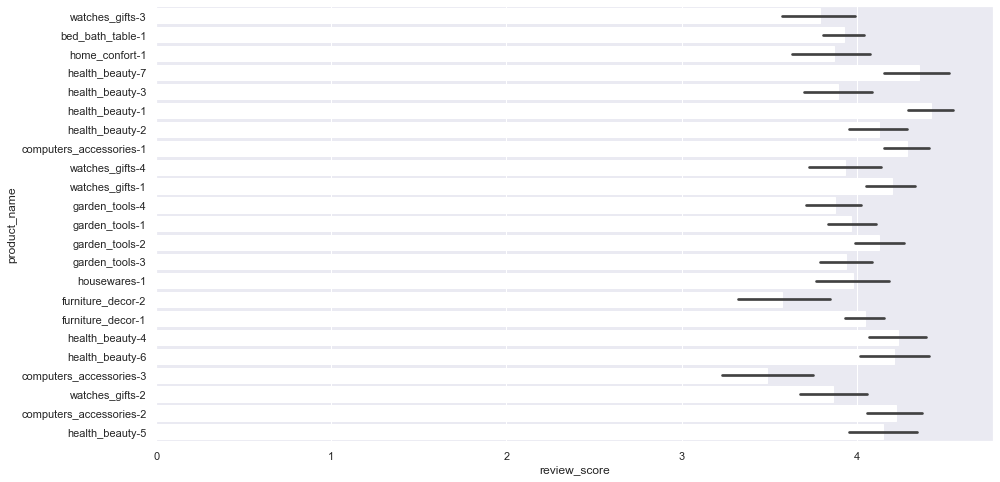

In [26]:
sns.set(rc = {'figure.figsize':(15,8)})
ax = sns.barplot(x="review_score", y="product_name", data=product_df, ci=95, color='white')
ax

### Regional analysis

We suspect that the reviews may differ across the country, hence it would be interesting to perform an analysis of the review based on the information from the geolocation dataset. This dataset allows us to analyze the orders and their reviews on a detailed level in terms of where in the country the packages are sent from and -to. Some of the regional analysis will be held on a state-level, which will give us a general image of the tendencies in the country.

We start by creating an instance of the main dataframe with only unique reviews. This dataframe does not contain all information regarding what products the orders consisted of, but the important thing for this regional analysis is the reviews as well as the spatial information. 

In [27]:
df_rev = df.drop_duplicates(['review_id'])

print('No. rows in review table:', len(df_rev))
print('No. unique reviews:', len(np.unique(df_rev.review_id.values)))
print('No. unique order IDs:', len(np.unique(df_rev.order_id.values)))

No. rows in review table: 92974
No. unique reviews: 92974
No. unique order IDs: 92974


For the state-level part of this regional analysis, we create a dataframe that averages reviews and all parameters over the 27 states in Brazil. 

In [28]:
customerstatesAveraged = df.groupby(by=['customer_state']).mean().reset_index()
customerstatesAveraged

,customer_state,order_item_id,review_score,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,...,product_width_cm,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,seller_zip_code_prefix,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller,rank
0,AC,1.238095,4.202381,179.469881,40.761429,46.702381,973.690476,2.380952,1954.714286,32.857143,...,22.154762,69914.726190,69914.726190,-9.937494,-68.068515,23474.952381,23474.952381,-22.514368,-47.224553,291.833333
1,AL,1.098558,3.831731,183.769856,35.975937,48.454327,885.158654,2.132212,1971.384615,29.504808,...,22.834135,57219.084135,57219.084135,-9.637874,-36.051635,28544.125000,28544.125000,-22.048736,-46.827068,274.694712
2,AM,1.183544,4.113924,135.595886,33.249241,48.196203,807.993671,2.303797,1546.189873,27.943038,...,21.962025,69077.639241,69077.639241,-3.206404,-60.062609,25443.582278,25443.582278,-23.110778,-47.143410,306.234177
3,AP,1.262500,4.262500,166.611375,34.281500,48.812500,782.525000,2.150000,1874.162500,30.362500,...,22.600000,68910.850000,68910.850000,0.050086,-51.173617,23152.775000,23152.775000,-22.482122,-46.817028,276.800000
4,BA,1.162553,3.876596,135.414477,26.382014,49.180993,834.182411,2.283972,2213.965957,30.095035,...,22.805390,44131.592908,44131.592908,-13.019796,-39.478233,21705.070922,21705.070922,-22.321839,-46.713620,292.281702
5,CE,1.156947,3.890569,153.680612,32.822621,49.243341,845.385889,2.399568,2008.573794,29.213103,...,21.501800,61623.352772,61623.352772,-4.342638,-38.964562,20510.658747,20510.658747,-22.303028,-46.753533,273.437005
6,DF,1.169621,4.054624,127.021672,21.188936,48.314806,843.334931,2.202204,1732.016770,29.148059,...,22.110206,71611.087686,71611.087686,-15.810253,-47.969319,27175.472448,27175.472448,-22.340849,-47.172100,326.863440
7,ES,1.144847,4.012071,117.744954,21.990427,48.872331,767.241876,2.225162,2102.564995,29.942433,...,22.928041,29298.981430,29298.981430,-20.145300,-40.491819,21823.953575,21823.953575,-22.452764,-47.027988,326.362581
8,GO,1.273405,4.036796,124.300065,22.755911,49.519329,801.549138,2.261761,1944.869585,29.895668,...,22.573824,74999.177457,74999.177457,-16.602646,-49.321080,22741.417327,22741.417327,-22.373399,-47.106419,306.780624
9,MA,1.162973,3.752282,146.458996,38.595984,49.842243,863.951760,2.473272,1981.190352,30.139505,...,22.020860,65336.504563,65336.504563,-3.553272,-44.703818,24523.432855,24523.432855,-22.057048,-46.833275,324.968709


#### Geo-Polygon data

For this state-level part of the regional analysis we join our states averaged dataframe with a geojson dataset containing multipolygons of each state in Brazil. It is multipolygons because many of the states have small islands as part of the state, but these islands are so small that they can be neglected in the visualization. 

In [29]:
path = 'archive/Brazil-states.geojson'
brazilStates = gpd.read_file(path)[['name', 'sigla', 'geometry']]

In [30]:
customerstatesAveraged = pd.merge(brazilStates, customerstatesAveraged, left_on=['sigla'], right_on=['customer_state'])

The mainland part of each state is always the zeroth element in the multipolygon, so when we want to move on with polygons, we simply just take the zeroth element of the multipolygons of each state.

In [31]:
def zeroth(multipolygon):
    polygons = [polygon for polygon in multipolygon.geoms]
    return polygons[0]

customerstatesAveraged['polygon'] = customerstatesAveraged.geometry.apply(zeroth)
customerstatesAveraged

,name,sigla,geometry,customer_state,order_item_id,review_score,price,freight_value,product_name_lenght,product_description_lenght,...,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,seller_zip_code_prefix,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller,rank,polygon
0,Acre,AC,"MULTIPOLYGON (((-73.60818 -7.20194, -72.86963 ...",AC,1.238095,4.202381,179.469881,40.761429,46.702381,973.690476,...,69914.726190,69914.726190,-9.937494,-68.068515,23474.952381,23474.952381,-22.514368,-47.224553,291.833333,"POLYGON ((-73.60818 -7.20194, -72.86963 -7.528..."
1,Alagoas,AL,"MULTIPOLYGON (((-35.46516 -8.82549, -35.46626 ...",AL,1.098558,3.831731,183.769856,35.975937,48.454327,885.158654,...,57219.084135,57219.084135,-9.637874,-36.051635,28544.125000,28544.125000,-22.048736,-46.827068,274.694712,"POLYGON ((-35.46516 -8.82549, -35.46626 -8.827..."
2,Amazonas,AM,"MULTIPOLYGON (((-67.32553 2.03012, -67.32234 2...",AM,1.183544,4.113924,135.595886,33.249241,48.196203,807.993671,...,69077.639241,69077.639241,-3.206404,-60.062609,25443.582278,25443.582278,-23.110778,-47.143410,306.234177,"POLYGON ((-67.32553 2.03012, -67.32234 2.01741..."
3,Amapá,AP,"MULTIPOLYGON (((-51.18168 4.00889, -51.17900 3...",AP,1.262500,4.262500,166.611375,34.281500,48.812500,782.525000,...,68910.850000,68910.850000,0.050086,-51.173617,23152.775000,23152.775000,-22.482122,-46.817028,276.800000,"POLYGON ((-51.18168 4.00889, -51.17900 3.99812..."
4,Bahia,BA,"MULTIPOLYGON (((-39.28820 -8.56290, -39.28229 ...",BA,1.162553,3.876596,135.414477,26.382014,49.180993,834.182411,...,44131.592908,44131.592908,-13.019796,-39.478233,21705.070922,21705.070922,-22.321839,-46.713620,292.281702,"POLYGON ((-39.28820 -8.56290, -39.28229 -8.567..."
5,Ceará,CE,"MULTIPOLYGON (((-40.01804 -2.83698, -40.00587 ...",CE,1.156947,3.890569,153.680612,32.822621,49.243341,845.385889,...,61623.352772,61623.352772,-4.342638,-38.964562,20510.658747,20510.658747,-22.303028,-46.753533,273.437005,"POLYGON ((-40.01804 -2.83698, -40.00587 -2.841..."
6,Espírito Santo,ES,"MULTIPOLYGON (((-40.72383 -20.84178, -40.72804...",ES,1.144847,4.012071,117.744954,21.990427,48.872331,767.241876,...,29298.981430,29298.981430,-20.145300,-40.491819,21823.953575,21823.953575,-22.452764,-47.027988,326.362581,"POLYGON ((-40.72383 -20.84178, -40.72804 -20.8..."
7,Goiás,GO,"MULTIPOLYGON (((-50.15776 -12.41195, -50.15901...",GO,1.273405,4.036796,124.300065,22.755911,49.519329,801.549138,...,74999.177457,74999.177457,-16.602646,-49.321080,22741.417327,22741.417327,-22.373399,-47.106419,306.780624,"POLYGON ((-50.15776 -12.41195, -50.15901 -12.4..."
8,Maranhão,MA,"MULTIPOLYGON (((-47.03102 -8.98549, -47.02113 ...",MA,1.162973,3.752282,146.458996,38.595984,49.842243,863.951760,...,65336.504563,65336.504563,-3.553272,-44.703818,24523.432855,24523.432855,-22.057048,-46.833275,324.968709,"POLYGON ((-47.03102 -8.98549, -47.02113 -8.987..."
9,Minas Gerais,MG,"MULTIPOLYGON (((-44.20886 -14.24413, -44.20871...",MG,1.182394,4.126143,120.720053,20.683879,48.803081,782.643797,...,35224.251324,35224.251324,-19.906241,-44.431769,25593.036351,25593.036351,-22.623589,-47.121441,322.590676,"POLYGON ((-44.20886 -14.24413, -44.20871 -14.2..."


We now have dataframe of 27 rows, where each row denotes a state (federal unit) with average values. 

Before we get into analyzing the olist dataset, a little contextual information on the country is provided using data provided by [statista](https://www.statista.com/). Brazil is large country with very different regions in terms of income and way of life. The most significant example is probably comparing life in the amazonas with life in the big cities like Rio De Janeiro and Sao Paolo. The plots below illustrate the population and income pr person for each state in Brazil. There are 27 states in Brazil, 26 federative units and the federal district.   

In [32]:
statistaData = pd.read_csv('archive/statistaBrazil.csv', delimiter=';')
customerstatesAveraged = pd.merge(customerstatesAveraged, statistaData, left_on=['sigla'], right_on=['State'])

Before we can plot the state populations we need to do a little data formatting. These formattings are specific to the kind of plot we'd like to create. We use the package called `pydeck`. First, the dataframe is converted to a GeoDataFrame, which has some particular properties. Secondly, the Polygon column is replaced by a column containing lists of coordinates instead.

In [33]:
geoDf = customerstatesAveraged[['name', 'price', 'freight_value', 'income', 'population','review_score','polygon']].copy()
geoDf = gpd.GeoDataFrame(geoDf)

def coord_lister(geom):
    coords = list(geom.exterior.coords)
    coords = ast.literal_eval(str(coords).replace('(','[').replace(')',']'))
    return [coords]

geoDf['coordinates'] = geoDf.polygon.apply(coord_lister)

The plots we want to make is 3D interactive and displays the geoplot i a really cool way. One of its properties is that datapoints (in our case polygons) can have different elevation depending on its values. The plot can also display the polygons in different colors depending the given values. To better determine the relative differences between states we normalize the populations using min-max normalization.

In [34]:
#minMax scaling
def minmaxscale(column):
    Min, Max = np.min(column), np.max(column)
    return (column-Min)/(Max-Min)

In [35]:
geoDf_pop = geoDf[['name', 'coordinates', 'population']].copy()
geoDf_pop.loc[:,'norm'] = minmaxscale(geoDf_pop.population.values)
geoDf_pop

,name,coordinates,population,norm
0,Acre,"[[[-73.608178, -7.201942], [-72.86963, -7.5285...",907,0.005522
1,Alagoas,"[[[-35.465161, -8.825492], [-35.46626, -8.8278...",3365,0.058962
2,Amazonas,"[[[-67.32553, 2.030119], [-67.322343, 2.017409...",4270,0.078637
3,Amapá,"[[[-51.181678, 4.008887], [-51.178999, 3.99811...",878,0.004892
4,Bahia,"[[[-39.288197, -8.562901], [-39.282291, -8.567...",14985,0.311592
5,Ceará,"[[[-40.018043, -2.836985], [-40.005873, -2.841...",9241,0.186712
6,Espírito Santo,"[[[-40.723829, -20.841778], [-40.72804, -20.84...",4109,0.075137
7,Goiás,"[[[-50.157762, -12.411952], [-50.159011, -12.4...",7207,0.142491
8,Maranhão,"[[[-47.031021, -8.98549], [-47.021131, -8.9873...",7153,0.141317
9,Minas Gerais,"[[[-44.208858, -14.244127], [-44.20871, -14.24...",21412,0.451322


Now, we're ready to plot the state populations. We create a generic function `state_polygons` that can be reused for other data points than the population. The function takes in the dataframe, the name of the feature(in this case population) and a description of the feature. It then plots the different polygons using the normalized values for elevation and color and creates a tooltip with the feature value and feature description.

In [36]:
def state_polygons(df, feature, feature_description):
    polygon_layer_merged = pdk.Layer(
    "PolygonLayer",
    df,
    id="geojson",
    opacity=0.9,
    stroked=False,
    get_polygon="coordinates",
    filled=True,
    extruded=True,
    wireframe=True,
    get_elevation="(500000*norm)",
    get_fill_color="[255-norm*255,0,norm*255, 255]",
    auto_highlight=True,
    pickable=True,
    )

    view_state = pdk.ViewState(
        longitude=-41.312633,
        latitude=-21.758076,
        zoom=3,
        min_zoom=3,
        max_zoom=20,
        pitch=60.5,
        bearing=0.00)
    html= "<b>State:</b> {name}<br /><b> "+ feature_description + ":</b> {"+feature+"}"
    tooltip = {"html": html}

    return pdk.Deck(polygon_layer_merged, initial_view_state=view_state, tooltip=tooltip,)

state_polygons(geoDf_pop, "population", "Population")


{"initialViewState": {"bearing": 0.0, "latitude": -21.758076, "longitude": -41.312633, "maxZoom": 20, "minZoom": 3, "pitch": 60.5, "zoom": 3}, "layers": [{"@@type": "PolygonLayer", "autoHighlight": true, "data": [{"coordinates": [[[-73.608178, -7.201942], [-72.86963, -7.528509], [-72.663035, -7.622899], [-72.660926, -7.623753], [-72.658816, -7.624607], [-72.189139, -7.720115], [-72.180896, -7.721791], [-72.172652, -7.723466], [-72.004612, -7.77447], [-71.512459, -7.886919], [-71.241081, -7.949829], [-70.936887, -8.018713], [-70.57532, -8.09556], [-70.368997, -8.141024], [-69.760758, -8.465852], [-69.552806, -8.577996], [-69.435256, -8.641215], [-69.177713, -8.767576], [-68.989072, -8.866179], [-68.784481, -8.972206], [-68.727521, -8.999689], [-68.620055, -9.047748], [-68.188419, -9.232315], [-67.939822, -9.336832], [-67.496119, -9.524192], [-67.327502, -9.594168], [-67.133347, -9.676444], [-67.105347, -9.687724], [-66.805966, -9.814127], [-66.689262, -9.862459], [-66.619301, -9.893602], [-66.622305, -9.896706], [-66.625906, -9.900375], [-66.623938, -9.906718], [-66.628579, -9.909211], [-66.63389, -9.913566], [-66.629792, -9.917826], [-66.630788, -9.922687], [-66.633443, -9.927309], [-66.631417, -9.928347], [-66.62707, -9.930572], [-66.626959, -9.935258], [-66.629883, -9.936321], [-66.632825, -9.937122], [-66.634258, -9.940488], [-66.635621, -9.94448], [-66.637944, -9.949046], [-66.642218, -9.948916], [-66.650033, -9.945058], [-66.650858, -9.941727], [-66.65193, -9.937394], [-66.655266, -9.940942], [-66.657149, -9.935893], [-66.662987, -9.940187], [-66.66656, -9.945882], [-66.663996, -9.948916], [-66.665647, -9.951662], [-66.666984, -9.953884], [-66.670893, -9.956723], [-66.674314, -9.957231], [-66.676078, -9.957493], [-66.676137, -9.958402], [-66.676298, -9.960907], [-66.675894, -9.964119], [-66.675809, -9.967702], [-66.678834, -9.967665], [-66.690304, -9.967506], [-66.695178, -9.967438], [-66.694511, -9.969565], [-66.694093, -9.970897], [-66.701736, -9.973638], [-66.706376, -9.975514], [-66.7114, -9.97722], [-66.714748, -9.978307], [-66.715103, -9.977867], [-66.717791, -9.974531], [-66.72065, -9.978118], [-66.721061, -9.980443], [-66.721462, -9.982712], [-66.723881, -9.982174], [-66.727459, -9.981378], [-66.731183, -9.980383], [-66.733589, -9.983136], [-66.734093, -9.988175], [-66.734544, -9.988717], [-66.739185, -9.994288], [-66.741502, -9.996387], [-66.74565, -9.995532], [-66.746772, -9.995301], [-66.750381, -9.994455], [-66.752756, -9.997069], [-66.755602, -9.999962], [-66.762183, -9.999667], [-66.764063, -10.006256], [-66.767463, -10.008149], [-66.770869, -10.010077], [-66.771382, -10.012649], [-66.771738, -10.014437], [-66.772827, -10.019699], [-66.777989, -10.01759], [-66.779416, -10.017007], [-66.783805, -10.019081], [-66.791315, -10.02392], [-66.79315, -10.026153], [-66.795502, -10.029016], [-66.799522, -10.032291], [-66.805684, -10.038192], [-66.804883, -10.039232], [-66.802052, -10.042908], [-66.80711, -10.047986], [-66.815978, -10.050795], [-66.822389, -10.058075], [-66.825713, -10.059661], [-66.827382, -10.06006], [-66.831334, -10.061006], [-66.835519, -10.06243], [-66.83493, -10.066202], [-66.83486, -10.066644], [-66.839853, -10.07098], [-66.838244, -10.082485], [-66.844112, -10.084674], [-66.847586, -10.085342], [-66.851636, -10.08608], [-66.851817, -10.080619], [-66.853095, -10.080982], [-66.854813, -10.081469], [-66.862027, -10.082741], [-66.866299, -10.084219], [-66.872661, -10.081206], [-66.87129, -10.086608], [-66.871457, -10.089736], [-66.871112, -10.093658], [-66.871334, -10.094367], [-66.873245, -10.100482], [-66.876346, -10.098863], [-66.877435, -10.098609], [-66.880427, -10.097911], [-66.881697, -10.101572], [-66.883522, -10.106834], [-66.88547, -10.104195], [-66.886448, -10.10287], [-66.887341, -10.105496], [-66.888185, -10.10798], [-66.890837, -10.113028], [-66.895233, -10.110983], [-66.895239, -10.11098], [-66.89524, -10.110988], [-66.896879, -10.118], [-66.898151, -10.119808], [-66.898155, -10.1198

Not surprisingly, the plot shows that states with a larger population are the states with large cities like Sao Paolo and Rio De Janeiro. Notice a large value is blue and a low value is red with this color palette. Values in between are some nuance of purple.

Let's continue and look at what states have the highest income pr person. This is easy now that the code is prepared.

In [37]:
geoDf_inc = geoDf[['name','coordinates', 'income']].copy()
geoDf_inc.loc[:,'norm'] = minmaxscale(geoDf_inc.income.values)

state_polygons(geoDf_inc, "income", "Income pr person")

{"initialViewState": {"bearing": 0.0, "latitude": -21.758076, "longitude": -41.312633, "maxZoom": 20, "minZoom": 3, "pitch": 60.5, "zoom": 3}, "layers": [{"@@type": "PolygonLayer", "autoHighlight": true, "data": [{"coordinates": [[[-73.608178, -7.201942], [-72.86963, -7.528509], [-72.663035, -7.622899], [-72.660926, -7.623753], [-72.658816, -7.624607], [-72.189139, -7.720115], [-72.180896, -7.721791], [-72.172652, -7.723466], [-72.004612, -7.77447], [-71.512459, -7.886919], [-71.241081, -7.949829], [-70.936887, -8.018713], [-70.57532, -8.09556], [-70.368997, -8.141024], [-69.760758, -8.465852], [-69.552806, -8.577996], [-69.435256, -8.641215], [-69.177713, -8.767576], [-68.989072, -8.866179], [-68.784481, -8.972206], [-68.727521, -8.999689], [-68.620055, -9.047748], [-68.188419, -9.232315], [-67.939822, -9.336832], [-67.496119, -9.524192], [-67.327502, -9.594168], [-67.133347, -9.676444], [-67.105347, -9.687724], [-66.805966, -9.814127], [-66.689262, -9.862459], [-66.619301, -9.893602], [-66.622305, -9.896706], [-66.625906, -9.900375], [-66.623938, -9.906718], [-66.628579, -9.909211], [-66.63389, -9.913566], [-66.629792, -9.917826], [-66.630788, -9.922687], [-66.633443, -9.927309], [-66.631417, -9.928347], [-66.62707, -9.930572], [-66.626959, -9.935258], [-66.629883, -9.936321], [-66.632825, -9.937122], [-66.634258, -9.940488], [-66.635621, -9.94448], [-66.637944, -9.949046], [-66.642218, -9.948916], [-66.650033, -9.945058], [-66.650858, -9.941727], [-66.65193, -9.937394], [-66.655266, -9.940942], [-66.657149, -9.935893], [-66.662987, -9.940187], [-66.66656, -9.945882], [-66.663996, -9.948916], [-66.665647, -9.951662], [-66.666984, -9.953884], [-66.670893, -9.956723], [-66.674314, -9.957231], [-66.676078, -9.957493], [-66.676137, -9.958402], [-66.676298, -9.960907], [-66.675894, -9.964119], [-66.675809, -9.967702], [-66.678834, -9.967665], [-66.690304, -9.967506], [-66.695178, -9.967438], [-66.694511, -9.969565], [-66.694093, -9.970897], [-66.701736, -9.973638], [-66.706376, -9.975514], [-66.7114, -9.97722], [-66.714748, -9.978307], [-66.715103, -9.977867], [-66.717791, -9.974531], [-66.72065, -9.978118], [-66.721061, -9.980443], [-66.721462, -9.982712], [-66.723881, -9.982174], [-66.727459, -9.981378], [-66.731183, -9.980383], [-66.733589, -9.983136], [-66.734093, -9.988175], [-66.734544, -9.988717], [-66.739185, -9.994288], [-66.741502, -9.996387], [-66.74565, -9.995532], [-66.746772, -9.995301], [-66.750381, -9.994455], [-66.752756, -9.997069], [-66.755602, -9.999962], [-66.762183, -9.999667], [-66.764063, -10.006256], [-66.767463, -10.008149], [-66.770869, -10.010077], [-66.771382, -10.012649], [-66.771738, -10.014437], [-66.772827, -10.019699], [-66.777989, -10.01759], [-66.779416, -10.017007], [-66.783805, -10.019081], [-66.791315, -10.02392], [-66.79315, -10.026153], [-66.795502, -10.029016], [-66.799522, -10.032291], [-66.805684, -10.038192], [-66.804883, -10.039232], [-66.802052, -10.042908], [-66.80711, -10.047986], [-66.815978, -10.050795], [-66.822389, -10.058075], [-66.825713, -10.059661], [-66.827382, -10.06006], [-66.831334, -10.061006], [-66.835519, -10.06243], [-66.83493, -10.066202], [-66.83486, -10.066644], [-66.839853, -10.07098], [-66.838244, -10.082485], [-66.844112, -10.084674], [-66.847586, -10.085342], [-66.851636, -10.08608], [-66.851817, -10.080619], [-66.853095, -10.080982], [-66.854813, -10.081469], [-66.862027, -10.082741], [-66.866299, -10.084219], [-66.872661, -10.081206], [-66.87129, -10.086608], [-66.871457, -10.089736], [-66.871112, -10.093658], [-66.871334, -10.094367], [-66.873245, -10.100482], [-66.876346, -10.098863], [-66.877435, -10.098609], [-66.880427, -10.097911], [-66.881697, -10.101572], [-66.883522, -10.106834], [-66.88547, -10.104195], [-66.886448, -10.10287], [-66.887341, -10.105496], [-66.888185, -10.10798], [-66.890837, -10.113028], [-66.895233, -10.110983], [-66.895239, -10.11098], [-66.89524, -10.110988], [-66.896879, -10.118], [-66.898151, -10.119808], [-66.898155, -10.1198

Not surprisingly, the states with big cities and in general the southern states are more wealthy. We also notice that the federal state has a very high income pr person, which also makes good sense.

Next, let's see if there is a pattern in the review scores and the geographical location. 

In [38]:
geoDf_review = geoDf[['name', 'review_score','coordinates']].round(2).copy()
geoDf_review.loc[:,'norm'] = minmaxscale(geoDf_review.review_score.values)

state_polygons(geoDf_review, "review_score", "Average review_score")

{"initialViewState": {"bearing": 0.0, "latitude": -21.758076, "longitude": -41.312633, "maxZoom": 20, "minZoom": 3, "pitch": 60.5, "zoom": 3}, "layers": [{"@@type": "PolygonLayer", "autoHighlight": true, "data": [{"coordinates": [[[-73.608178, -7.201942], [-72.86963, -7.528509], [-72.663035, -7.622899], [-72.660926, -7.623753], [-72.658816, -7.624607], [-72.189139, -7.720115], [-72.180896, -7.721791], [-72.172652, -7.723466], [-72.004612, -7.77447], [-71.512459, -7.886919], [-71.241081, -7.949829], [-70.936887, -8.018713], [-70.57532, -8.09556], [-70.368997, -8.141024], [-69.760758, -8.465852], [-69.552806, -8.577996], [-69.435256, -8.641215], [-69.177713, -8.767576], [-68.989072, -8.866179], [-68.784481, -8.972206], [-68.727521, -8.999689], [-68.620055, -9.047748], [-68.188419, -9.232315], [-67.939822, -9.336832], [-67.496119, -9.524192], [-67.327502, -9.594168], [-67.133347, -9.676444], [-67.105347, -9.687724], [-66.805966, -9.814127], [-66.689262, -9.862459], [-66.619301, -9.893602], [-66.622305, -9.896706], [-66.625906, -9.900375], [-66.623938, -9.906718], [-66.628579, -9.909211], [-66.63389, -9.913566], [-66.629792, -9.917826], [-66.630788, -9.922687], [-66.633443, -9.927309], [-66.631417, -9.928347], [-66.62707, -9.930572], [-66.626959, -9.935258], [-66.629883, -9.936321], [-66.632825, -9.937122], [-66.634258, -9.940488], [-66.635621, -9.94448], [-66.637944, -9.949046], [-66.642218, -9.948916], [-66.650033, -9.945058], [-66.650858, -9.941727], [-66.65193, -9.937394], [-66.655266, -9.940942], [-66.657149, -9.935893], [-66.662987, -9.940187], [-66.66656, -9.945882], [-66.663996, -9.948916], [-66.665647, -9.951662], [-66.666984, -9.953884], [-66.670893, -9.956723], [-66.674314, -9.957231], [-66.676078, -9.957493], [-66.676137, -9.958402], [-66.676298, -9.960907], [-66.675894, -9.964119], [-66.675809, -9.967702], [-66.678834, -9.967665], [-66.690304, -9.967506], [-66.695178, -9.967438], [-66.694511, -9.969565], [-66.694093, -9.970897], [-66.701736, -9.973638], [-66.706376, -9.975514], [-66.7114, -9.97722], [-66.714748, -9.978307], [-66.715103, -9.977867], [-66.717791, -9.974531], [-66.72065, -9.978118], [-66.721061, -9.980443], [-66.721462, -9.982712], [-66.723881, -9.982174], [-66.727459, -9.981378], [-66.731183, -9.980383], [-66.733589, -9.983136], [-66.734093, -9.988175], [-66.734544, -9.988717], [-66.739185, -9.994288], [-66.741502, -9.996387], [-66.74565, -9.995532], [-66.746772, -9.995301], [-66.750381, -9.994455], [-66.752756, -9.997069], [-66.755602, -9.999962], [-66.762183, -9.999667], [-66.764063, -10.006256], [-66.767463, -10.008149], [-66.770869, -10.010077], [-66.771382, -10.012649], [-66.771738, -10.014437], [-66.772827, -10.019699], [-66.777989, -10.01759], [-66.779416, -10.017007], [-66.783805, -10.019081], [-66.791315, -10.02392], [-66.79315, -10.026153], [-66.795502, -10.029016], [-66.799522, -10.032291], [-66.805684, -10.038192], [-66.804883, -10.039232], [-66.802052, -10.042908], [-66.80711, -10.047986], [-66.815978, -10.050795], [-66.822389, -10.058075], [-66.825713, -10.059661], [-66.827382, -10.06006], [-66.831334, -10.061006], [-66.835519, -10.06243], [-66.83493, -10.066202], [-66.83486, -10.066644], [-66.839853, -10.07098], [-66.838244, -10.082485], [-66.844112, -10.084674], [-66.847586, -10.085342], [-66.851636, -10.08608], [-66.851817, -10.080619], [-66.853095, -10.080982], [-66.854813, -10.081469], [-66.862027, -10.082741], [-66.866299, -10.084219], [-66.872661, -10.081206], [-66.87129, -10.086608], [-66.871457, -10.089736], [-66.871112, -10.093658], [-66.871334, -10.094367], [-66.873245, -10.100482], [-66.876346, -10.098863], [-66.877435, -10.098609], [-66.880427, -10.097911], [-66.881697, -10.101572], [-66.883522, -10.106834], [-66.88547, -10.104195], [-66.886448, -10.10287], [-66.887341, -10.105496], [-66.888185, -10.10798], [-66.890837, -10.113028], [-66.895233, -10.110983], [-66.895239, -10.11098], [-66.89524, -10.110988], [-66.896879, -10.118], [-66.898151, -10.119808], [-66.898155, -10.1198

The plot shows that many of the less rich northern states have lower average review scores. There may be a connection here, but states like Amapa and Acra indicate that it is not only about income. These states are also some of the least populated states in the country, so it may have something to do with sample size. 


## Freight cost

This next section will analyse the effect of freight cost on the average review scores. The freight cost is supposedly dependent on how far the package is being shipped and how heavy the package is. However, the customer may find their overall experience less satisfying if they're paying a lot in freight cost. The relation between review score and freight costs is what we analyze in this chapter.
First, let's just plot the freight values of all reviewed orders in a histogram. We use the `plotly express`library for this. This will give us a better understanding of the specific feature.

In [39]:
fig = px.histogram(df_rev, x="freight_value", labels={"freight_value": "Freight cost"}, nbins=120)
fig.show()

From the histogram it can be observed that by far the most orders have a freight value between 7.5 and 28 reais (we assume the unit is reais but we don't know for sure). Let's continue by plotting the relation between different levels of freight cost and review scores. We do that by creating a bar plot with binned freight cost values in the x-axis and average freight cost in the y-axis. For this, we create the bins manually before using plotly express once again.

In [40]:
freight_values = []
counts = []
review_scores = []
for i in range(5,85,5):
    temp = df_rev[(df_rev.freight_value < i) & (df_rev.freight_value >= i-5)]
    freight_values.append(f'{i-5} - {i}')
    counts.append(len(temp))
    review_scores.append(np.mean(temp.review_score.values))

df_dt = pd.DataFrame({'Freight cost': freight_values, 'Count':counts, 'Review score': review_scores})

In [41]:
px.bar(df_dt, x="Freight cost", y="Review score",
             color='Count', color_continuous_scale=px.colors.sequential.Blues)

The bar plot reveals that there is a general pattern of worse reviews when higher freight costs. However, interestingly enough the orders with a freight cost of less than 5 reais actually have a very low review score. This could possibly be because the customer was given a discount in freight cost as a result of an unsatisfying experience, or maybe it is just a coincidence. 

The freight cost may be dependent on what state the package is sent to. Therefore we check to see if there is a difference in the average freight value across states.

In [42]:
geoDf_freight = geoDf[['name', 'freight_value','coordinates']].round(2).copy()
geoDf_freight.loc[:,'norm'] = minmaxscale(geoDf_freight.freight_value.values)

state_polygons(geoDf_freight, "freight_value", "Average order freight cost")

{"initialViewState": {"bearing": 0.0, "latitude": -21.758076, "longitude": -41.312633, "maxZoom": 20, "minZoom": 3, "pitch": 60.5, "zoom": 3}, "layers": [{"@@type": "PolygonLayer", "autoHighlight": true, "data": [{"coordinates": [[[-73.608178, -7.201942], [-72.86963, -7.528509], [-72.663035, -7.622899], [-72.660926, -7.623753], [-72.658816, -7.624607], [-72.189139, -7.720115], [-72.180896, -7.721791], [-72.172652, -7.723466], [-72.004612, -7.77447], [-71.512459, -7.886919], [-71.241081, -7.949829], [-70.936887, -8.018713], [-70.57532, -8.09556], [-70.368997, -8.141024], [-69.760758, -8.465852], [-69.552806, -8.577996], [-69.435256, -8.641215], [-69.177713, -8.767576], [-68.989072, -8.866179], [-68.784481, -8.972206], [-68.727521, -8.999689], [-68.620055, -9.047748], [-68.188419, -9.232315], [-67.939822, -9.336832], [-67.496119, -9.524192], [-67.327502, -9.594168], [-67.133347, -9.676444], [-67.105347, -9.687724], [-66.805966, -9.814127], [-66.689262, -9.862459], [-66.619301, -9.893602], [-66.622305, -9.896706], [-66.625906, -9.900375], [-66.623938, -9.906718], [-66.628579, -9.909211], [-66.63389, -9.913566], [-66.629792, -9.917826], [-66.630788, -9.922687], [-66.633443, -9.927309], [-66.631417, -9.928347], [-66.62707, -9.930572], [-66.626959, -9.935258], [-66.629883, -9.936321], [-66.632825, -9.937122], [-66.634258, -9.940488], [-66.635621, -9.94448], [-66.637944, -9.949046], [-66.642218, -9.948916], [-66.650033, -9.945058], [-66.650858, -9.941727], [-66.65193, -9.937394], [-66.655266, -9.940942], [-66.657149, -9.935893], [-66.662987, -9.940187], [-66.66656, -9.945882], [-66.663996, -9.948916], [-66.665647, -9.951662], [-66.666984, -9.953884], [-66.670893, -9.956723], [-66.674314, -9.957231], [-66.676078, -9.957493], [-66.676137, -9.958402], [-66.676298, -9.960907], [-66.675894, -9.964119], [-66.675809, -9.967702], [-66.678834, -9.967665], [-66.690304, -9.967506], [-66.695178, -9.967438], [-66.694511, -9.969565], [-66.694093, -9.970897], [-66.701736, -9.973638], [-66.706376, -9.975514], [-66.7114, -9.97722], [-66.714748, -9.978307], [-66.715103, -9.977867], [-66.717791, -9.974531], [-66.72065, -9.978118], [-66.721061, -9.980443], [-66.721462, -9.982712], [-66.723881, -9.982174], [-66.727459, -9.981378], [-66.731183, -9.980383], [-66.733589, -9.983136], [-66.734093, -9.988175], [-66.734544, -9.988717], [-66.739185, -9.994288], [-66.741502, -9.996387], [-66.74565, -9.995532], [-66.746772, -9.995301], [-66.750381, -9.994455], [-66.752756, -9.997069], [-66.755602, -9.999962], [-66.762183, -9.999667], [-66.764063, -10.006256], [-66.767463, -10.008149], [-66.770869, -10.010077], [-66.771382, -10.012649], [-66.771738, -10.014437], [-66.772827, -10.019699], [-66.777989, -10.01759], [-66.779416, -10.017007], [-66.783805, -10.019081], [-66.791315, -10.02392], [-66.79315, -10.026153], [-66.795502, -10.029016], [-66.799522, -10.032291], [-66.805684, -10.038192], [-66.804883, -10.039232], [-66.802052, -10.042908], [-66.80711, -10.047986], [-66.815978, -10.050795], [-66.822389, -10.058075], [-66.825713, -10.059661], [-66.827382, -10.06006], [-66.831334, -10.061006], [-66.835519, -10.06243], [-66.83493, -10.066202], [-66.83486, -10.066644], [-66.839853, -10.07098], [-66.838244, -10.082485], [-66.844112, -10.084674], [-66.847586, -10.085342], [-66.851636, -10.08608], [-66.851817, -10.080619], [-66.853095, -10.080982], [-66.854813, -10.081469], [-66.862027, -10.082741], [-66.866299, -10.084219], [-66.872661, -10.081206], [-66.87129, -10.086608], [-66.871457, -10.089736], [-66.871112, -10.093658], [-66.871334, -10.094367], [-66.873245, -10.100482], [-66.876346, -10.098863], [-66.877435, -10.098609], [-66.880427, -10.097911], [-66.881697, -10.101572], [-66.883522, -10.106834], [-66.88547, -10.104195], [-66.886448, -10.10287], [-66.887341, -10.105496], [-66.888185, -10.10798], [-66.890837, -10.113028], [-66.895233, -10.110983], [-66.895239, -10.11098], [-66.89524, -10.110988], [-66.896879, -10.118], [-66.898151, -10.119808], [-66.898155, -10.1198

From the plot above it can be observed that there is a pattern between freight costs and what state you're from. If you compare this plot to the geoplot with income pr person, they look opposite, ie. negatively correlated.

The freight cost could very well be related to the distance the ordered package needs to travel. To analyze this, we first need to compute the travelled distance. We do this by using the longitude/latitude's of the seller and the customer and calculate the distance between these. Although a package can end up travelling much further that this considering that the shipment rout rarely is on the direct between the two locations, this distance measure should give a relatively accurate estimate of the distance travelled. The distance is computed using the library `geopy`.

In [43]:
import geopy.distance

In [44]:
def coord_distance(row):
    seller = (row['geolocation_lng_seller'],row['geolocation_lat_seller'])
    customer = (row['geolocation_lng'],row['geolocation_lat'])

    return geopy.distance.geodesic(seller, customer).km

In [45]:
df_rev['distance'] = df_rev.apply(lambda row: coord_distance(row), axis=1)

We plot the distance travelled to see if this 

In [46]:
px.scatter(x=df_rev.distance.values, y=df_rev.freight_value)

The scatter plot above reveals a slight correlation between the distance travelled and the freight cost. Let's see if we can identify a correlation between the distance and the review scores.

In [47]:
distances = []
counts = []
review_scores = []
for i in range(300,2500,300):
    temp = df_rev[(df_rev.distance < i) & (df_rev.distance >= i-300)]
    distances.append(f'{i-300} - {i}')
    counts.append(len(temp))
    review_scores.append(np.mean(temp.review_score.values))

df_dt = pd.DataFrame({'Distance': distances, 'Count':counts, 'Review score': review_scores})

In [48]:
px.bar(df_dt, x="Distance", y="Review score",
             color='Count', color_continuous_scale=px.colors.sequential.Blues)

Similar to the freight cost, we see a negative correlation between the distance travelled and the review score.

## Delivery time analysis

In this section we will analyze the relationship between the delivery time and the review score. The dataset does not contain value denoting the delivery time, bu instead it has different `datetime`objects denoting specific points in time of interest:

- `order_purchase_timestamp`: The time and date the customer purchased the order.
- `order_delivered_customer_date`: The time and date the customer recieved the package.
- `order_estimated_delivery_date`: The time and date the customer is expected to recieve the package.

Using these datetime objects we can derive more useful features for our problem. For example, if a packacke is delayed, i.e. `order_delivered_customer_date` is after `order_estimated_delivery_date`, the customer may be more prone to leave a bad review. Let's look into that, but first we derive the following features:

- `delivery_time`: The number of days gone from `order_purchase_timestamp` to `order_delivered_customer_date`.
- `estimated_time`: The number of days gone from `order_purchase_timestamp` to `order_estimated_delivery_date`.
- `delay`: The number of days gone from `order_estimated_delivery_date` to `order_delivered_delivery_date`.

These features are derived in the below cells using the library `datetime`.


In [49]:
from datetime import datetime

In [50]:
purchased = df_rev.order_purchase_timestamp.values
purchased = [datetime.strptime(pur, '%Y-%m-%d %H:%M:%S') for pur in purchased]


delivered = df_rev.order_delivered_customer_date.values
delivered = [datetime.strptime(deli, '%Y-%m-%d %H:%M:%S') for deli in delivered]


estimated = df_rev.order_estimated_delivery_date.values 
estimated = [datetime.strptime(est, '%Y-%m-%d %H:%M:%S') for est in estimated]

delivery_time = []
delays = []
estimated_time = []
for i in range(len(purchased)):
    
    delivery_time.append( (delivered[i]-purchased[i]).days  )
    delays.append(  (delivered[i]-estimated[i]).days )
    estimated_time.append( (estimated[i]-purchased[i]).days )

In [51]:
print('Average delivery time: ', np.mean(delivery_time))
print('Average estimated time: ', np.mean(estimated_time))
print('Average delay: ', np.mean(delays))

Average delivery time:  12.024598274786499
Average estimated time:  23.345709553208422
Average delay:  -11.918267472626756


A quick look at our new three features reveals that the average delay is actually -11.92 days, which means that the package in average arrives about 12 days before the estimated arrival. This must mean that the estimated delivery date is a conservative estimate. Nevertheless, these features intuitively have an effect on the review score, but let's analyze it to be certain. Let's start by adding the features to the dataframe.

In [52]:
df_rev.loc[:,'delivery_time'] = delivery_time.copy()
df_rev.loc[:,'estimated_time'] = estimated_time.copy()
df_rev.loc[:,'delays'] = delays.copy()

Alright, let's start by analyzing the correlation between delivery time and review scores. We follow the same procedure as we did with freight costs. We start by plotting the distribution of delivery time, so we can create a suitable number of bins for our barplot.

In [53]:
fig = px.histogram(df_rev, x="delivery_time", labels={"delivery_time": "Actual delivery time"}, nbins=60)
fig.show()

In [54]:
delivery_times = []
counts = []
review_scores = []
for i in range(5,50,5):
    temp = df_rev[(df_rev.delivery_time <= i) & (df_rev.delivery_time > i-5)]
    delivery_times.append(f'{i-5} - {i}')
    counts.append(len(temp))
    review_scores.append(np.mean(temp.review_score.values))

df_dt = pd.DataFrame({'Delivery time': delivery_times, 'Count':counts, 'Review score': review_scores})

In [55]:
px.bar(df_dt, x="Delivery time", y="Review score",
             color='Count', labels={
                     "Delivery time": "Actual delivery time", "Review score":"Average Review score"}, color_continuous_scale=px.colors.sequential.Blues)

The plot above reveals a clear correlation between the delivery time and the average review score. Notice, each bin in the plot has many observations, although the colors of the bars indicate otherwise. The 40-45 days bin has 595 observations and an average review score of 1.86 compared to orders with a delivery time of 5-10 with an average score of 4.35.

Next up, let see if there is any correlation between the estimated delivery and the review score. One would expect that the consumer does not let how long the estimated delivery time is affect the review score, but let's see.

In [56]:
fig = px.histogram(df_rev, x="estimated_time", labels={
                     "estimated_time": "Estimated delivery time"}, nbins=60)
fig.show()

In [57]:
delivery_times = []
counts = []
review_scores = []
for i in range(5,50,5):
    temp = df_rev[(df_rev.estimated_time <= i) & (df_rev.estimated_time > i-5)]
    delivery_times.append(f'{i-5}-{i}')
    counts.append(len(temp))
    review_scores.append(np.mean(temp.review_score.values))

df_et = pd.DataFrame({'Estimated delivery time': delivery_times, 'Count':counts, 'Review score': review_scores})

In [58]:
px.bar(df_et, x="Estimated delivery time", y="Review score",
             color='Count', labels={
                     "Estimated delivery time": "Estimated delivery time", "Review score":"Average Review score"}, color_continuous_scale=px.colors.sequential.Blues)

The plot above shows that there is a, although not as strong as with delivery time, correlation between estimated time. This may just be caused by the review score's correlation with the delivery time. Orders with long estimated deliveries will expectedly also have long delivery times.

Lastly, we perform the same analysis with delays. 

In [59]:
fig = px.histogram(df_rev, x="delays", labels={
                     "Delays": "delays"}, nbins=60)
fig.show()

In [60]:
delays = []
counts = []
review_scores = []
for i in range(-50,30,5):
    temp = df_rev[(df_rev.delays <= i) & (df_rev.delays > i-5)]
    delays.append(f'{i-5} to {i}')
    counts.append(len(temp))
    review_scores.append(np.mean(temp.review_score.values))

df_del = pd.DataFrame({'Delays': delays, 'Count':counts, 'Average review score': review_scores})

In [61]:
px.bar(df_del, x="Delays", y="Average review score",
             color='Count', labels={ "Review score":"Average Review score"}, color_continuous_scale=px.colors.sequential.Blues)

The plot shows a dramatic decrease in the average review score once the delay exceeds 0, i.e. when the order is delayed. It seems as if all orders that are not delayed, no matter how much before the estimated delivery they're delivered, are all fairly evenly distributed an average review score of above 4.1. The average review score for orders that are delayed with only 0-5 days is 2.99! The customers will NOT accept a delayed package!

The delay is basically just the relationship between the estimated- and the actual delivery time. The heatmap plot below visualizes how customers in general respond to different scenarios. The horizontal axis represents the estimated time of delivery and the vertical axis represents the actual time of delivery, i.e. the diagonal of the heatmap represents the scenarios where the delay is around zero days. 

In [62]:
import plotly.graph_objects as go

In [63]:
labs ={"estimated_time":"Estimated delivery time", "delivery_time":"Delivery time", "review_score": "Review score"}
fig = px.density_heatmap(df_rev, x="estimated_time", y="delivery_time", z="review_score", histfunc="avg",
                        labels=labs, nbinsx=60, nbinsy=60, width=800, height=700)

fig.update_yaxes(range=[60, 0])
fig.update_xaxes(range=[0, 60], side="top")


fig.show()

From the heatmap, it can be seen that there is a general tendency of higher average review scores, when the estimated time of delivery is lower than the actual time of delivery. However, this plot does not reveal how many observations we have for each scenario. The plot below shows the same relationship but with regards to the number of observations instead of the average review score. 

In [64]:
labs ={"estimated_time":"Estimated delivery time", "delivery_time":"Delivery time"}
fig = px.density_heatmap(df_rev, x="estimated_time", y="delivery_time",
                        labels=labs, nbinsx=60, nbinsy=60, width=800, height=700)

fig.update_yaxes(range=[60, 0])
fig.update_xaxes(range=[0, 60], side="top")


fig.show()

The count heatmap reveals that most of the observations are located above the diagonal, meaning that there is negative delay. It is actually very few observations that have large delays, and it seems as if Olist already has a very conservative estimation of the time of delivery.

### Product presentation

Another interesting thing to look into is the quality of the product description. From the dataset we cannot quantify the actual quality, but we can look into the number of words used to describe the product and the number of photos of the product. Intuitively it makes sense that a well desribed product will get better reviews, because the customer will have more accurate expectations. This section will test if the number of photos, `product_photos_qty`, and the number of signs, `product_description_lenght`, that were used in the description of the product, will affect the average reviews. We start by analyzing the number of photos 

In [65]:
fig = px.histogram(df_rev, x="product_photos_qty", labels={
                     "Delays": "product_photos_qty"}, nbins=20)
fig.show()

In [66]:
photos = []
counts = []
review_scores = []
for i in range(1,7):
    if i <= 5:
        temp = df[df.product_photos_qty == i]
    else:
        temp = df[df.product_photos_qty > 5]
    i = str(i) if i <= 5 else 'more'
    photos.append(i)
    counts.append(len(temp))
    review_scores.append(np.mean(temp.review_score.values))

df_pho = pd.DataFrame({'No. product photos': photos, 'Count':counts, 'Review score': review_scores})
df_pho

,No. product photos,Count,Review score
0,1,53447,4.053735
1,2,21013,4.111978
2,3,11850,4.129030
3,4,8077,4.099294
4,5,5175,4.196522
5,more,6515,4.119110


In [67]:
px.bar(df_pho, x='No. product photos', y="Review score",
             color='Count', color_continuous_scale=px.colors.sequential.Blues)

From the plot above we see that the average review score is higher for products with more than 1 photo. However, there doesn't seem to be a consisten tendency of more photos resulting in better reviews. This may be because a lot of products does not need photos from multiple angles. However, if the description only has one photo it may seem more unreliable. 

Let's go on to the number of signs used in the description.

In [68]:
fig = px.histogram(df_rev, x="product_description_lenght", labels={
                     "product_description_lenght": "Product description lenght"}, nbins=20)
fig.show()

In [69]:
words = []
counts = []
review_scores = []
for i in range(200,1400,200):
    if i <= 1000:
        temp = df_rev[(df_rev.product_description_lenght <= i) & (df_rev.product_description_lenght > i-201)]
    else:
        temp = df_rev[df_rev.product_description_lenght > i]
    i = str(i) if i <= 1000 else 'more'
    words.append(i)
    counts.append(len(temp))
    review_scores.append(np.mean(temp.review_score.values))

df_wor = pd.DataFrame({'Maximum no. product description signs': words, 'Count':counts, 'Review score': review_scores})
df_wor

,Maximum no. product description signs,Count,Review score
0,200,7991,4.132649
1,400,20374,4.132571
2,600,17711,4.166902
3,800,13791,4.171489
4,1000,10444,4.190444
5,more,16607,4.191486


In [70]:
fig = px.bar(df_wor, x='Maximum no. product description signs', y="Review score",
             color='Count', color_continuous_scale=px.colors.sequential.Blues)

fig.update_yaxes(range=[3.9, 4.6])



fig.show()

From the plot above, we see that the number of signs used in the product description (binned on every 200) is positively correlated with the average review score. This is an interesting finding but goes to show that the customers are careful and appreciates a thorough description of the product. Once again, this my just be a proxy for the type of products that actually requires more description, but nevertheless it seems as a useful feature if one were to predict the review score of an order.

## Machine learning model

In this section, we will try to predict the review score of orders using machine learning. The objective is not to optimize performance but to derive which features actually helps the model the most, i.e. perform a feature importance analysis. We will use the features that appear to be correlated with the review score of an order based on the analysis in the previous section.

First, we need to develop a model. In general, when predicting ordered classes, it is widely used to treat it as a regression task and then afterwards perform some sort of rounding on the prediction to get discrete classes, which is what we will do. As our prediction model we use the `CatBoostRegresser`, which, besides having good regression performance, has the property of effectively prediction on cetegorical features such the `product_name`and `Customer_state` features. The model will be evaluated using MAE and RMSE, where the MAE indicates the average absolute error and and the difference between MAE and RMSE indicates the error variance.

We use the `sklearn` library, which makes it very straight-forward to implement machine learning models.

In [71]:
from catboost import CatBoostRegressor

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error


import shap

In [72]:
def round_reg(preds):
    for i,x in enumerate(preds):
        x = np.ceil(x)
        x = 1 if x < 1 else x
        x = 5 if x > 5 else x
        preds[i] = x
    return preds

def stats(preds, true):
    
    MAE = mean_absolute_error(true, preds)
    RMSE = mean_squared_error(true, preds, squared=False)
    return MAE, RMSE

def trainmodel(x,y, model):
    X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size = 0.2)
    model.fit(X_train, Y_train);  
    preds = model.predict(X_test);
    
    preds = round_reg(preds)
    
    return preds, Y_test, X_train, model

Before we train our model, we need to define our features, `x`, and our prediction variable, `y`. 

We obviously want the review score as our prediction variable, an based on our analysis above, we select the following features:

- `price`
- `freight value`
- `product_photos_qty`
- `product_description_lenght`
- `delivery_time`
- `estimated_time`
- `delays`

In [73]:
y = df_rev.review_score.values.astype(int)
x = df_rev[['price','freight_value', 'product_photos_qty', 'product_description_lenght', 'delivery_time', 'delays', 'customer_state', 'product_category_name_english']]

Before we actually train and evaluate our model, it is valuable to establish a baseline performance. Because we know from the previous analysis that 5 is the most frequent review score, our baseline model will be to simply just predict on every order. 

In [74]:
MAE, RMSE = stats(5*np.ones(len(y)), y)
print('naive MAE: ', MAE)
print('naive RMSE: ', RMSE)

naive MAE:  0.8387828855378923
naive RMSE:  1.5302747144553983


The above performance is basically just a naive guess, which is why we call it 'naive'. Let's get on with the Machine Learning model.

We use the CatBoost Regression Model as our model architecture. Let's see if it ouperforms the naive model.

In [75]:
model = CatBoostRegressor(iterations=10000, verbose=2000, loss_function='MAE', cat_features=['customer_state', 'product_category_name_english'])
preds, Y_test, X_train, model = trainmodel(x, y, model);



0:	learn: 0.8338304	total: 83.2ms	remaining: 13m 51s
2000:	learn: 0.7170051	total: 31.7s	remaining: 2m 6s
4000:	learn: 0.7151711	total: 1m 6s	remaining: 1m 38s
6000:	learn: 0.7132538	total: 1m 41s	remaining: 1m 7s
8000:	learn: 0.7119748	total: 2m 12s	remaining: 33.2s
9999:	learn: 0.7106982	total: 2m 43s	remaining: 0us


In [76]:
MAE, RMSE = stats(preds, Y_test)
print('model MAE: ', MAE)
print('model RMSE: ', RMSE)

model MAE:  0.7257327238504975
model RMSE:  1.337666616290369


The results show that our CatBoost Regression Model actually outperforms the naive model. Both in terms of MAE and then RMSE. This means our model has learned some of the correlations between our selected features and is not just guessing!

We plot the predictions up against the true labels in a heatmap to visualize our performance. 

In [77]:
px.density_heatmap(x=preds, y=Y_test, labels={"x": "Predicted Review Score", "y": "True Review Score"})

From the histogram above, the true predictions are in the dianogal going from the bottom left corner to the top right corner. False predictions above this diagonal are cases, where our prediction was lower than the true review score, and below the diagonal are cases, where our predictions are above the true review score. It is apparent that the far majority of our true predictions comes from predicting a review score of 5. Also, in general, our false predictions are cases where we actually overestimate the review score, which is probably a result of how unbalanced the dataset is.

Now, the interesting insight for Olist is not that we can predict the review scores to some degree, but it is important to see what features are important to these predictions, i.e. which features has the most influence on the review score according to the data. 

To analyze feature importance, we use the library `shap`. 

In [78]:
shap_values = shap.TreeExplainer(model).shap_values(X_train)

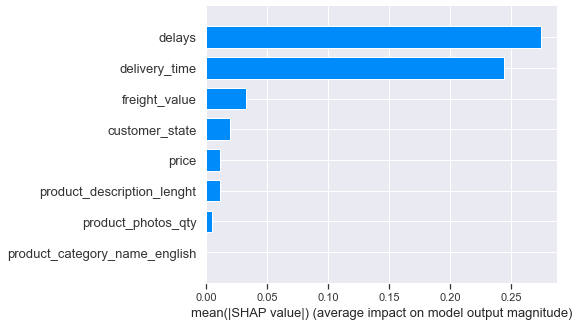

In [79]:
shap.summary_plot(shap_values, X_train, plot_type="bar")

The bar plot shows the results of the feature importance analysis. The x-axis denotes how impactful the features are on the predicted review score at average (it depends on its value). We see that delay and delivery time are both very impactful. This is an interesting finding to report to Olist. It can alo be observed that the freight cost has a pretty high impact on the output. The plot also reveals that the product category has zero impact on the predictions, but the other categorical feature, `customer state`, actually has some impact on the solution.

Although we also can use reasoning for this, let's look at how the different features impact the solution.

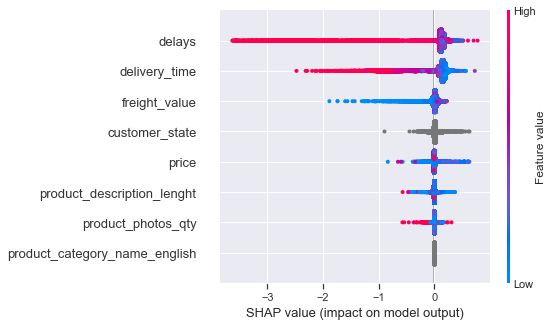

In [80]:
shap.summary_plot(shap_values, X_train)

The plot above indicates whether the feature's impact is either positive or negative and uses colors to show if the feature value was high or low. Looking at the most impactful feature, delays, it can be observed that when the delays value is high, it has a very negative effect on the predicted review score. The same goes with high delivery times. However, since delays are derived from the delivery time, delivery time will typically have a high value if delays have a high value. 

## 4. Genre

### Which genre of data story did you use?

The story of this notebook is author-driven, which means that it has a linear ordering and heavy messaging and little reader interaction. However, the majority of the plots actually have some level of interactivity. In the histograms, heatmaps and bar plots made in `plotly`, the reader is able to hover over the plot to gain relevant information, and in the geoplots, the reader is also able to hover over each state as well as move around and zoom in the frame. This level of interactivity allows the reader to further explore the visualisations, but the overall story is still driven by the author. With this in mind, the genre of our data story is much like an interactive slide show, where the overall narrative is controlled by the author, us, but the reader is then allowed to further explore some of the visualisations.

The slide show genre fits well with our case, since we pretend to be consultants presenting our findings to Olist. Such a presentation could very well be done in powerpoint and thereby have the same linear data structure. 

### Which tools did you use from each of the 3 categories of Visual Narrative. Why?

- As a **Visual structuring** tool we used a consistent visual platform in our analysis section. The consistency came from using not only the same colorpalette but the same type of plots to visualise the different features' correlation with the average review score. The same procedure was repeated for each interesting feature, because it was the same question we wanted to ask for each feature: Does this feature correlate with the review score?


- An example of how we use **Highlighting** was our geoplots, where we used both colors and size/elevation to visualize what states that have a high value. This is useful because it makes it very clear for the reader when there is a geographical pattern, almost unmissable.


- We used **textual transistion** guidance between all visualisations as a way of keeping the reader's focus on the narrative that we want to tell. Most of our transitions contain an interpretation of the visualization above and then a motivation for the visualisation below.

### Which tools did you use from each of the 3 categories of Narrative Structure. Why?

- The **ordering** of the visualisations is very linear as we have selected an author-driven path. This ordering seemed like a good fit for the narrative we wanted to build with us being consultants that are presenting to the client.


- Although we control the narrative of the story, many of our visualisations have **interactivity**. The geoplots are interactive in terms of both zoom, navigating and hovering, while the barplots, heatmaps and histograms have hovering.  We believe even the slightest level of interactivity gives the reader a higher level of engagement and thereby comprehends the intended points better.


- In the Machine Learning Model section, our feature importance plots are good examples of **Messaging**. With the narrative in mind, the plots are actually giving the recommendations by visualising exactly how important the features are and how they impact the predictions. 

## 5. Visualizations

### Explain the visualizations you've chosen, and why are they right for the story you want to tell?

In general, our choices of visualizations in this analysis have been centered around the review score, which is an ordinal variable. Because we want to investigate what order features that affect the review scores, it is natural that most visualizations involve the average review score of some grouping across order features. This is exactly what our visualizations do, and therefore the most frequently used visualization in this analysis is a simple barplot, where the average review score is the y-variable and the orders grouped on features are the x-variables. However in specific cases, such as the geographical analysis, the average review score is better visualized in a different way. In the geographical analysis, the average review score was better visualized in a geoplot, since the grouped orders depend on location, which the map visualized very well. Finally the visualizations for the Machine Learning model feature importance analysis was a completely different case in terms of visualization.    



## 6. Discussion 

### What went well?

This analysis focused on finding some general order features that can be used to explain the review score. This was very successful as we managed to find some very significant correlations between review score and features such as the delay and the freight cost. These findings can be utilized by olist to know what to improve on in the future. Fewer delays and less freight costs would be ways of improving their business when evaluting on the review score. However, these features are both also very tied to the profit that the company can make on each order. This is a dilemma that the company needs to assess: are we willing to decrease the order profit to increase order review scores?

### What can be improved?

A further analysis that could be made using this dataset would be to dive into the customers and their habits. An idea could be to conduct a segmentation analysis based on what product the customers buy, which naturally leads to developing a recommender system. Knowing the customers better may also provide knowledge for the investigation of the review score as it would be interesting to see the average review score across these customer segments. This analysis could still have been conducted, but as mentioned in this notebook, very few products have many orders and very few customers have many orders, which means the results would not be very representative.  

## 7. Contributions 

Although we both have contributed to everything in the project, Anders was more responsible for the website, while Jakob was more responsible for the explainer notebook.